# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, num_classes=n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), 1)
    #### END CODE HERE ####
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #print(discriminator_im_chan)
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.39092550265789, discriminator loss: 0.25503388096764684


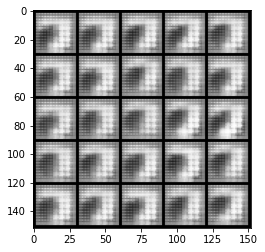

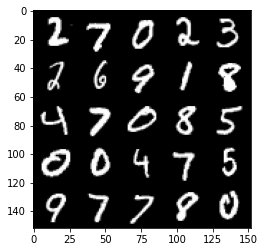

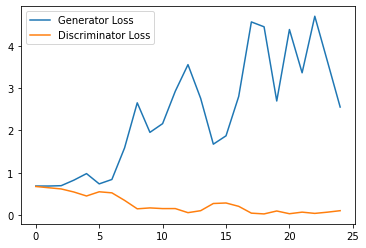

Step 1000: Generator loss: 3.7501985133886335, discriminator loss: 0.10850061043165624


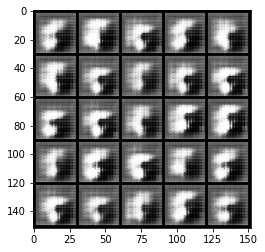

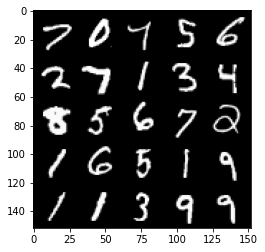

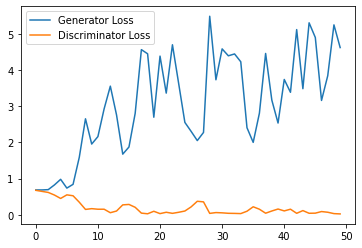

Step 1500: Generator loss: 4.235175632476807, discriminator loss: 0.06807994439452887


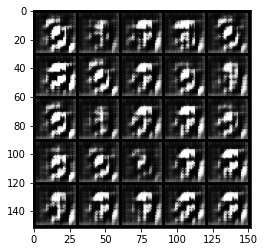

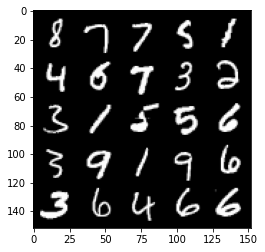

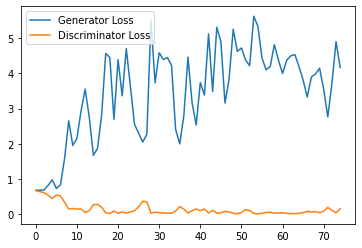

Step 2000: Generator loss: 3.3062438411712645, discriminator loss: 0.15592270492017268


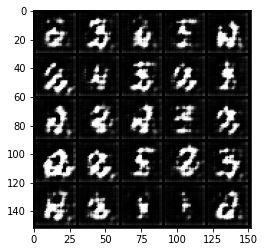

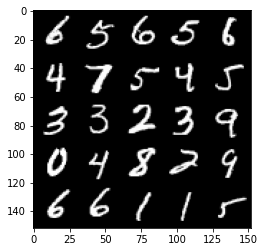

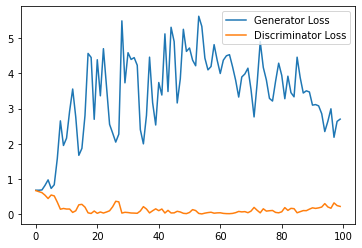

Step 2500: Generator loss: 2.4898438794612883, discriminator loss: 0.2600206977725029


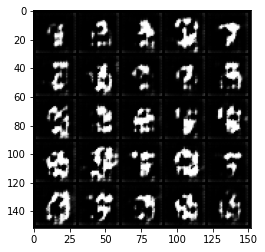

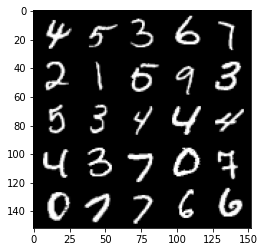

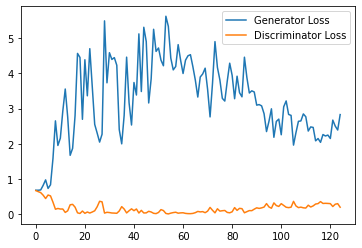

Step 3000: Generator loss: 2.2434344441890715, discriminator loss: 0.2893067837357521


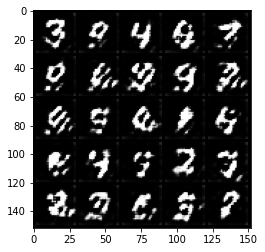

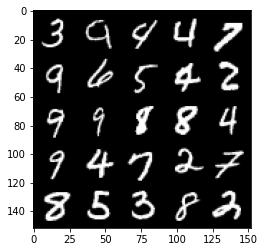

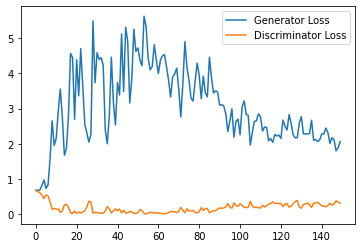

Step 3500: Generator loss: 2.1992391052246094, discriminator loss: 0.3119547541737556


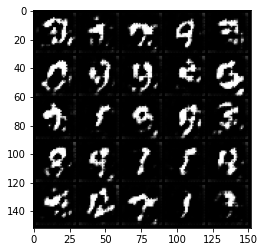

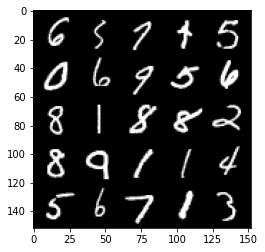

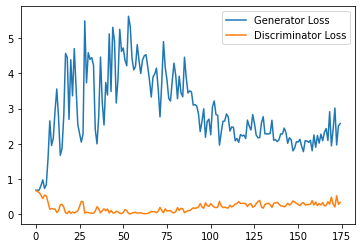

Step 4000: Generator loss: 2.053398140668869, discriminator loss: 0.3416973760426045


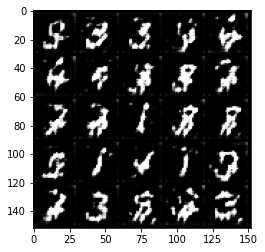

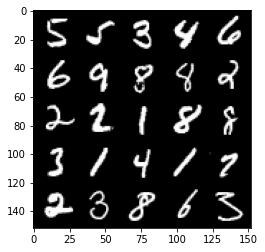

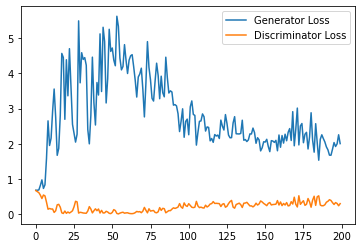

Step 4500: Generator loss: 1.916411387681961, discriminator loss: 0.3544361410439014


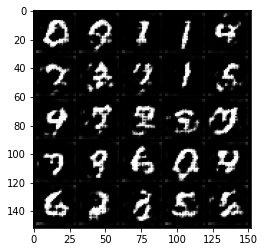

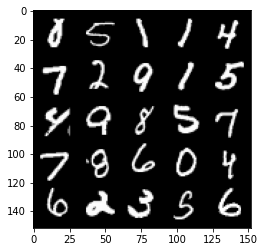

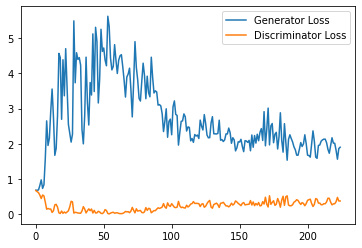

Step 5000: Generator loss: 1.783326595544815, discriminator loss: 0.3818403252363205


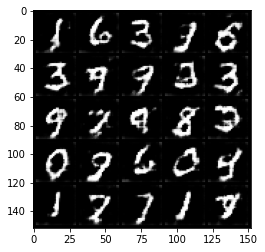

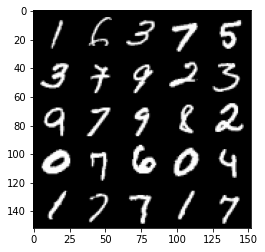

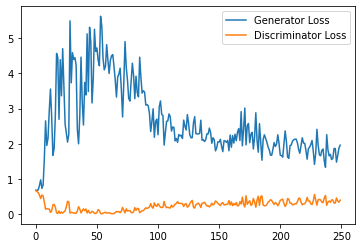

Step 5500: Generator loss: 1.7419767806529998, discriminator loss: 0.41472784581780436


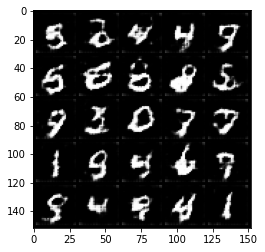

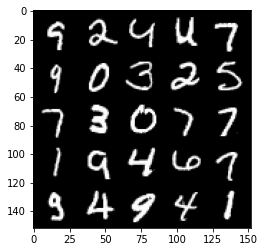

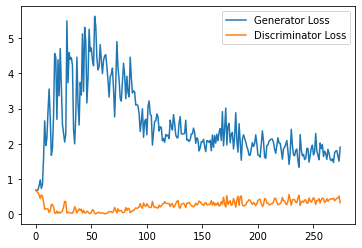

Step 6000: Generator loss: 1.6285875611305236, discriminator loss: 0.41576278656721116


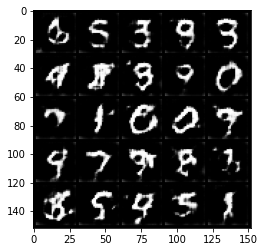

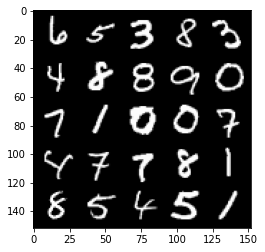

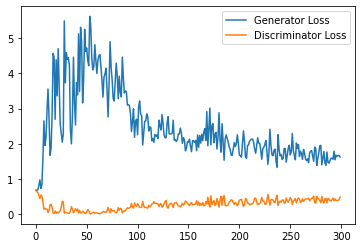

Step 6500: Generator loss: 1.5937791051864625, discriminator loss: 0.4294070556759834


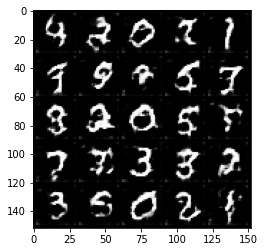

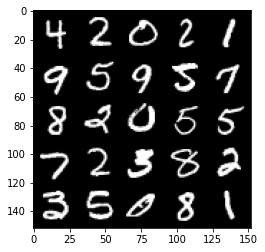

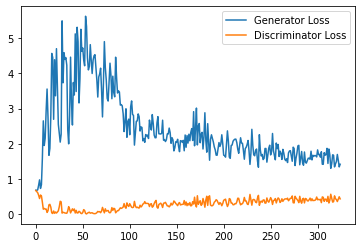

Step 7000: Generator loss: 1.4395317174196243, discriminator loss: 0.46346952056884766


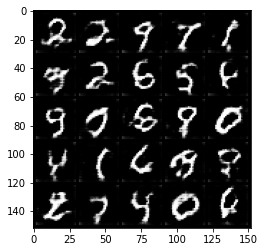

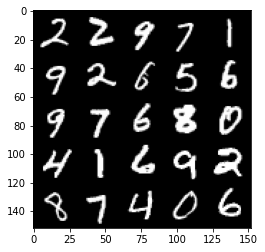

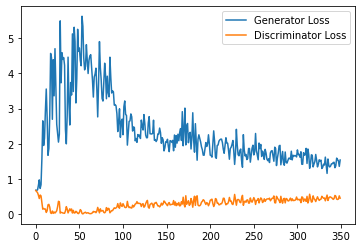

Step 7500: Generator loss: 1.4566649360656738, discriminator loss: 0.4996392982602119


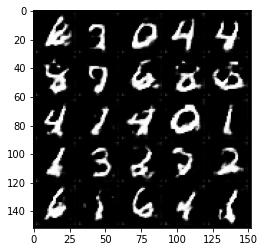

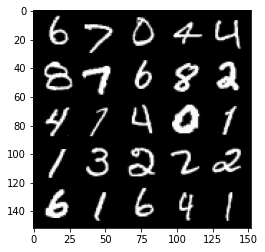

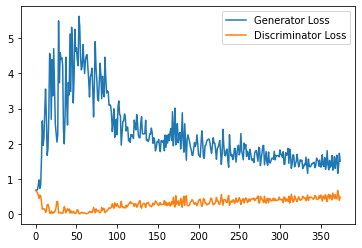

Step 8000: Generator loss: 1.3833078327178956, discriminator loss: 0.5251741198897362


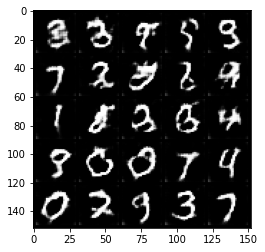

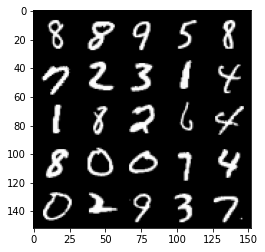

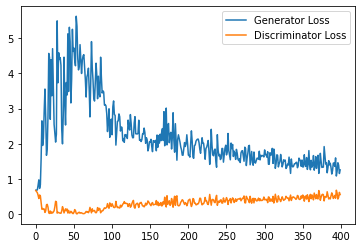

Step 8500: Generator loss: 1.3055827370882034, discriminator loss: 0.5206172514557839


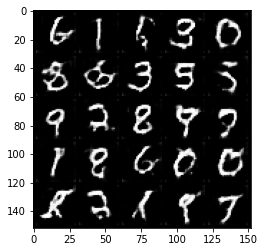

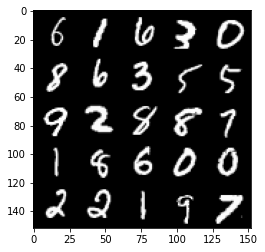

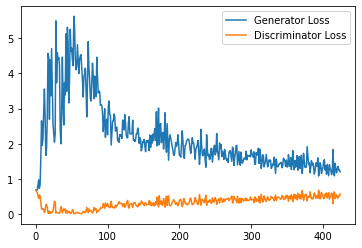

Step 9000: Generator loss: 1.343597236275673, discriminator loss: 0.5235846903920174


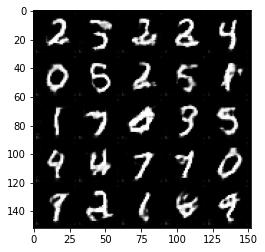

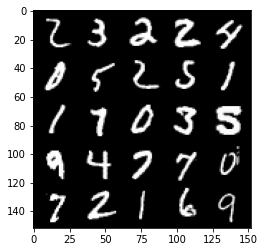

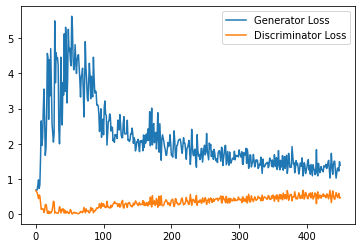

Step 9500: Generator loss: 1.1593804355859756, discriminator loss: 0.5487091932296753


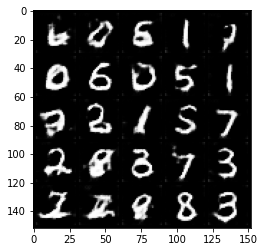

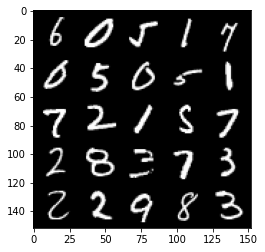

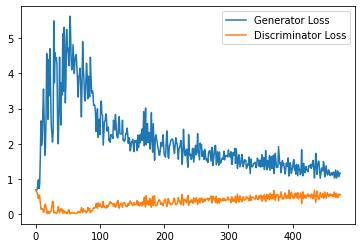

Step 10000: Generator loss: 1.240642342686653, discriminator loss: 0.5392299463748932


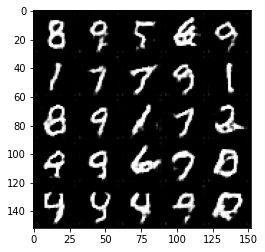

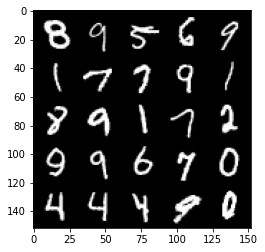

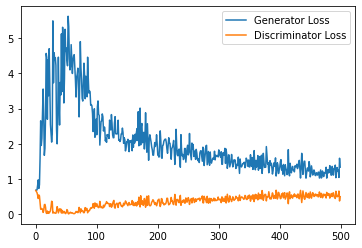

Step 10500: Generator loss: 1.2254633997678757, discriminator loss: 0.5376152579188347


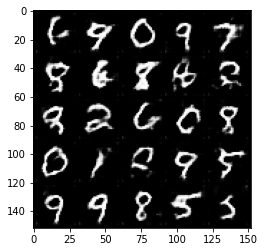

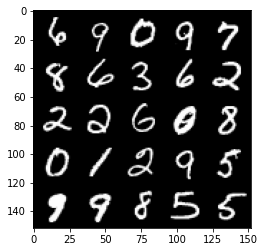

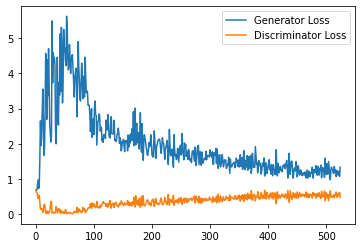

Step 11000: Generator loss: 1.1537860382795333, discriminator loss: 0.5537469284534454


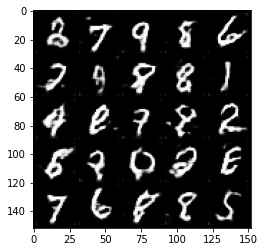

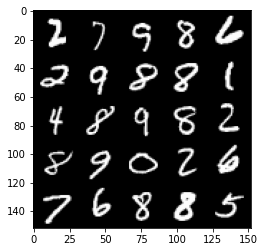

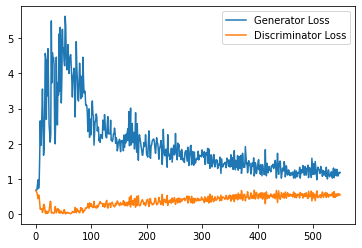

Step 11500: Generator loss: 1.140388341665268, discriminator loss: 0.556435707449913


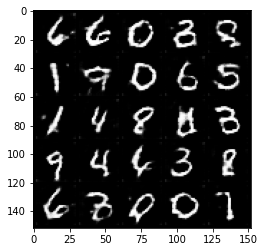

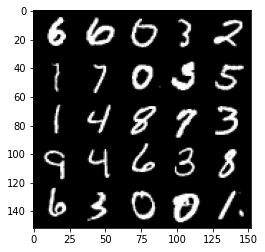

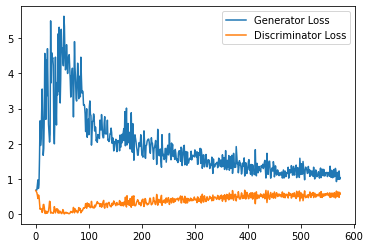

Step 12000: Generator loss: 1.1365029284954071, discriminator loss: 0.5640195963382721


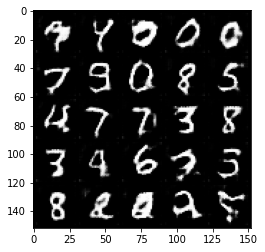

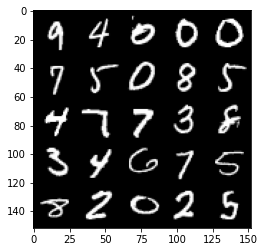

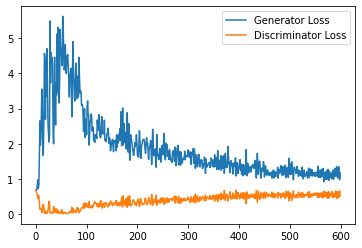

Step 12500: Generator loss: 1.115985673546791, discriminator loss: 0.5793169040679932


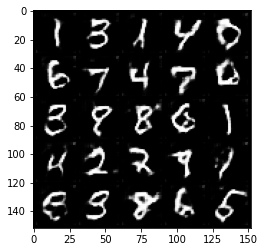

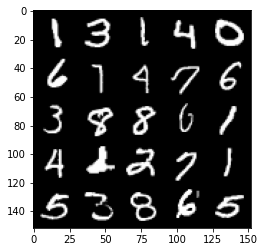

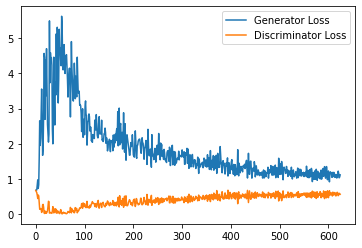

Step 13000: Generator loss: 1.1229002212285994, discriminator loss: 0.5737052257657052


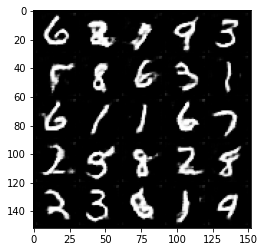

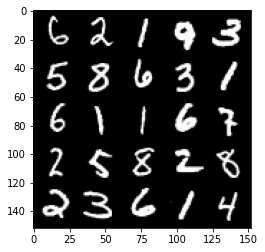

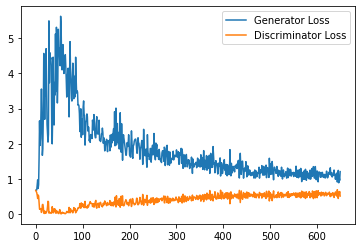

Step 13500: Generator loss: 1.055170728802681, discriminator loss: 0.5830065332651139


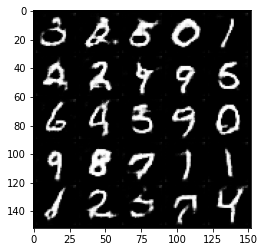

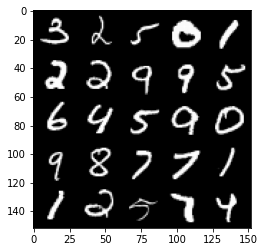

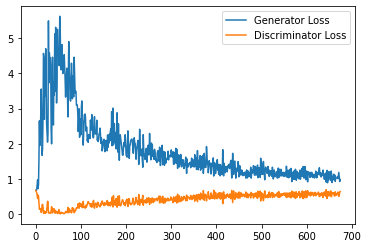

Step 14000: Generator loss: 1.0816749749183654, discriminator loss: 0.5919734736680985


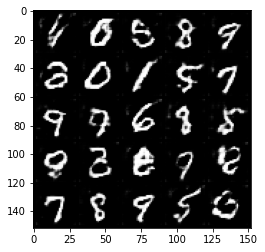

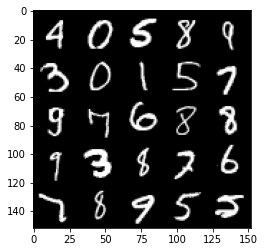

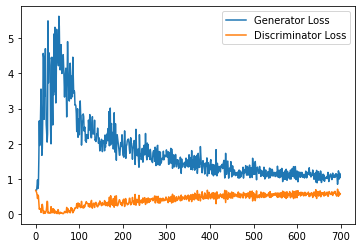

Step 14500: Generator loss: 1.0477179037332536, discriminator loss: 0.5906535275578498


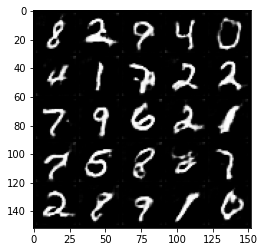

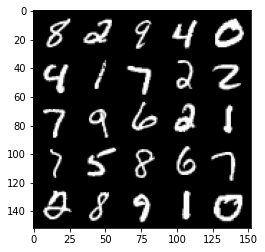

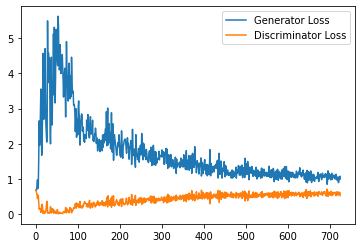

Step 15000: Generator loss: 1.0420703599452972, discriminator loss: 0.5989493398666382


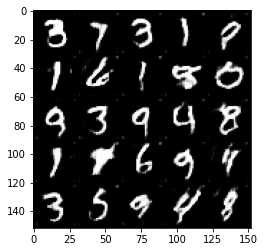

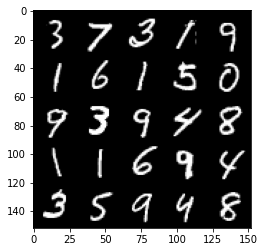

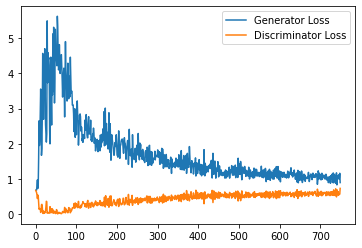

Step 15500: Generator loss: 1.0783493416309358, discriminator loss: 0.5836952946782112


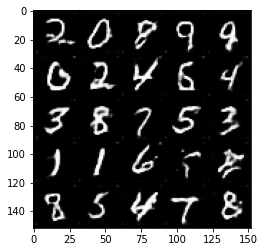

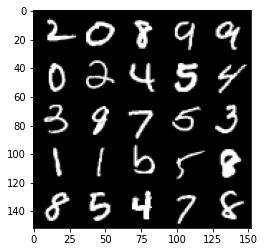

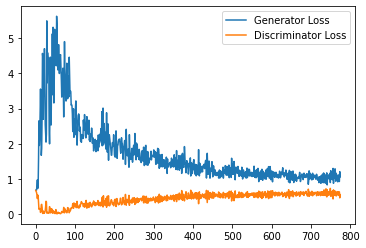

Step 16000: Generator loss: 1.0029522387981415, discriminator loss: 0.5987529987692833


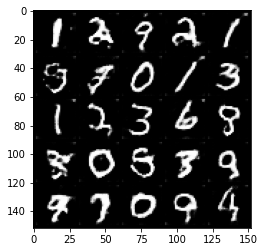

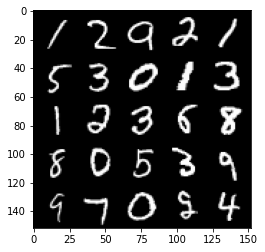

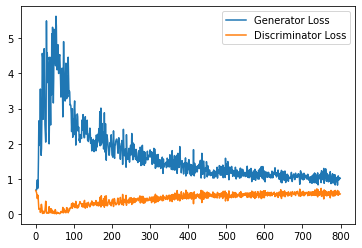

Step 16500: Generator loss: 1.0762879494428634, discriminator loss: 0.6077876717448235


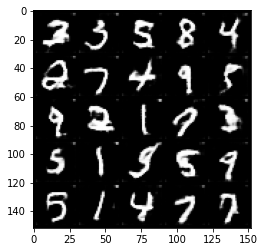

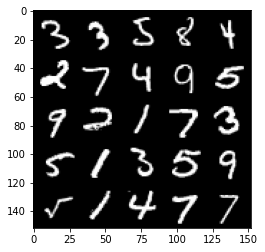

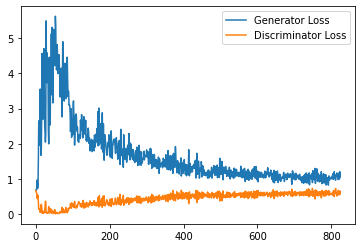

Step 17000: Generator loss: 1.0565794979333878, discriminator loss: 0.5990267671942711


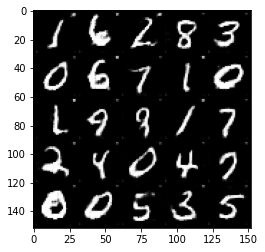

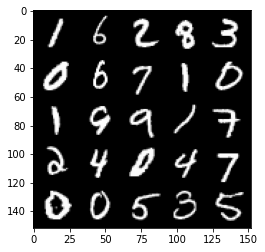

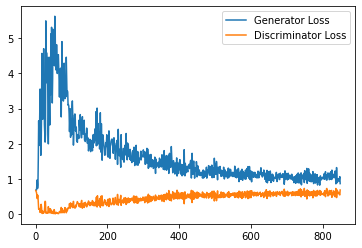

Step 17500: Generator loss: 0.9820268133878708, discriminator loss: 0.6032838492393494


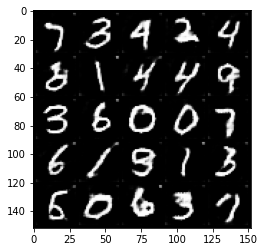

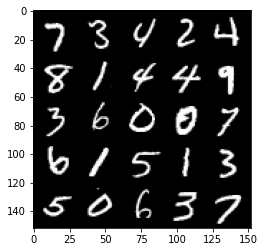

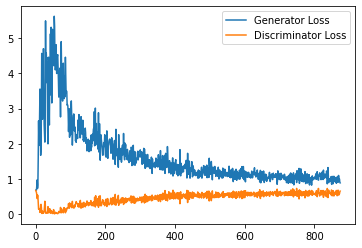

Step 18000: Generator loss: 1.0112518377304076, discriminator loss: 0.5930872381329536


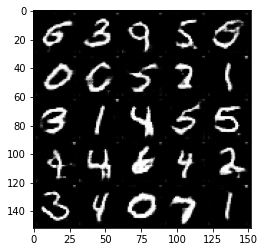

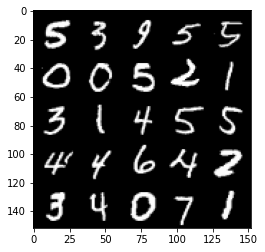

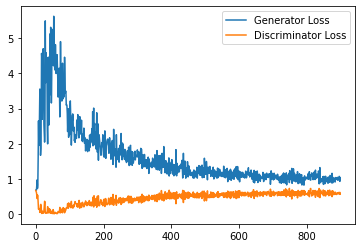

Step 18500: Generator loss: 1.0269332497119903, discriminator loss: 0.6000467150211334


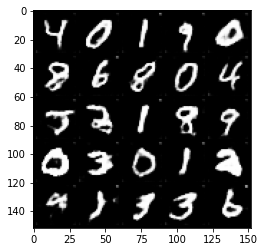

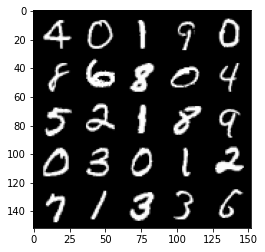

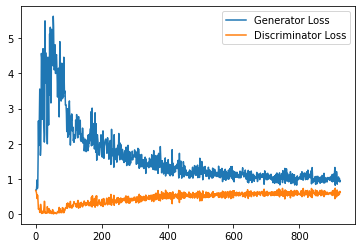

Step 19000: Generator loss: 1.0057195603847504, discriminator loss: 0.6014012643098832


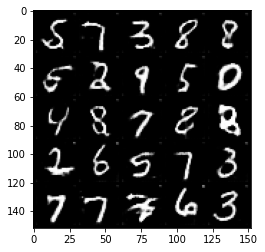

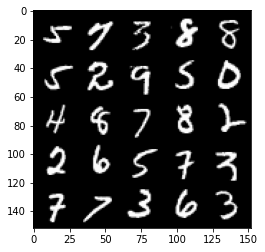

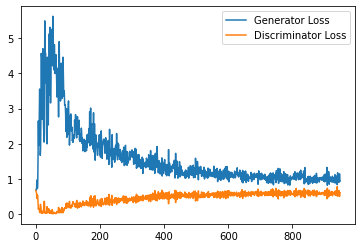

Step 19500: Generator loss: 0.9920064880847931, discriminator loss: 0.5905929419994355


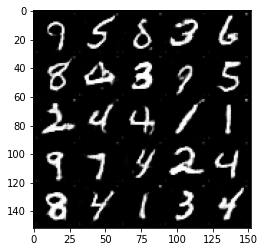

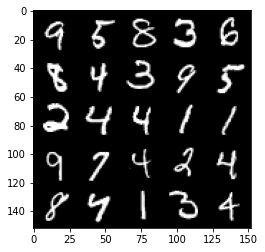

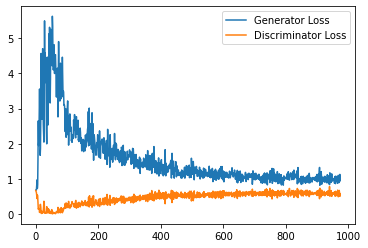

Step 20000: Generator loss: 0.9909379019737243, discriminator loss: 0.5985479819774627


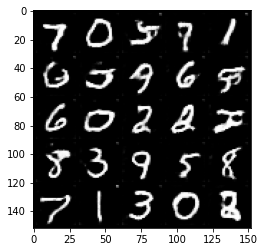

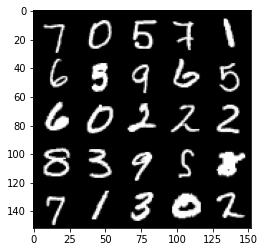

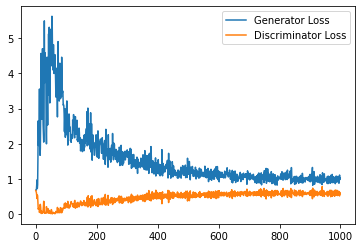

Step 20500: Generator loss: 1.0119720791578293, discriminator loss: 0.6028225264549255


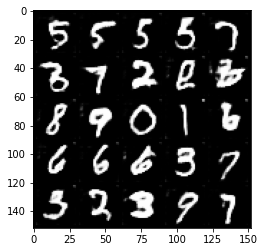

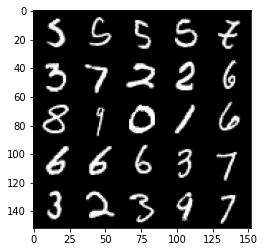

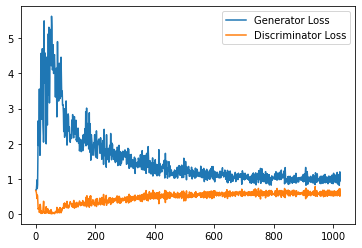

Step 21000: Generator loss: 1.007955959558487, discriminator loss: 0.6031189322471618


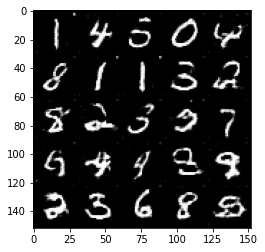

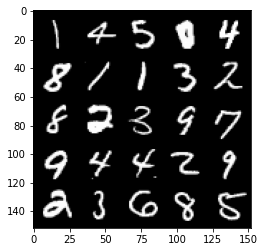

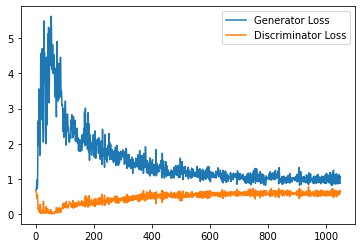

Step 21500: Generator loss: 0.9879981963634491, discriminator loss: 0.6043202099204064


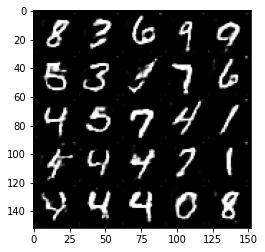

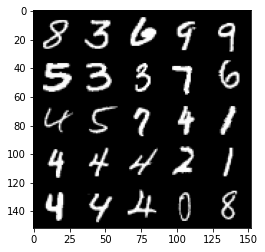

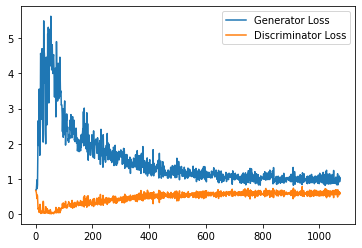

Step 22000: Generator loss: 1.0184798369407653, discriminator loss: 0.6017762761712074


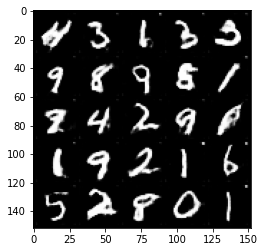

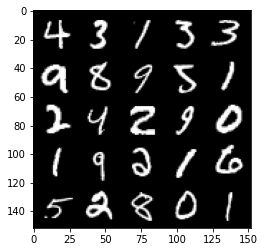

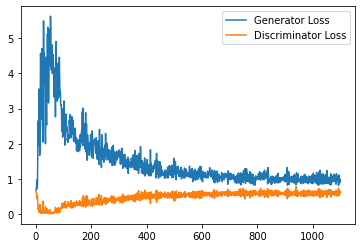

Step 22500: Generator loss: 0.9835376390218735, discriminator loss: 0.6016145038604737


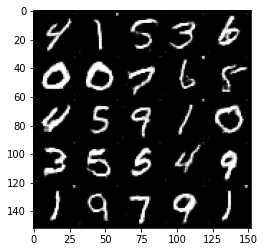

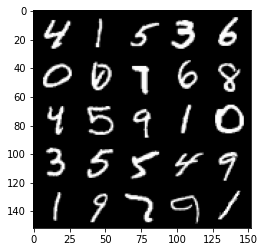

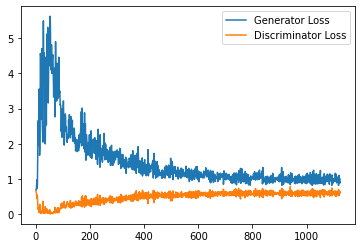

Step 23000: Generator loss: 0.9775643399953842, discriminator loss: 0.5980872556567192


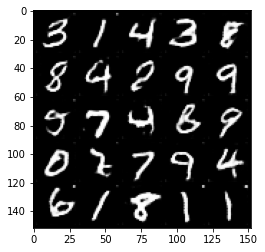

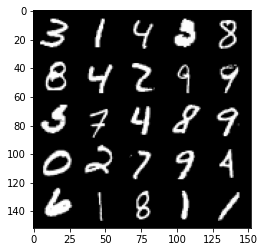

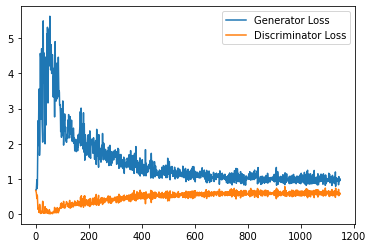

Step 23500: Generator loss: 0.9680267646312714, discriminator loss: 0.6060306185483932


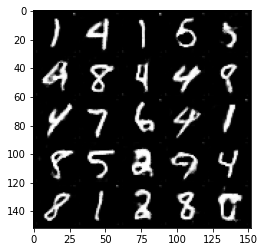

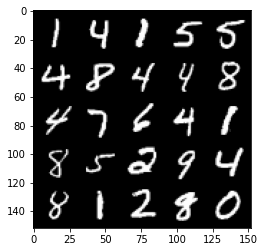

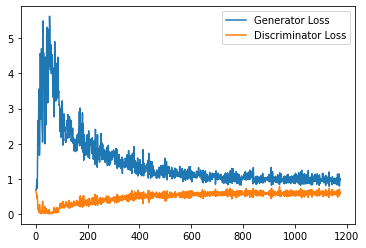

Step 24000: Generator loss: 0.9799320876598359, discriminator loss: 0.6056489900350571


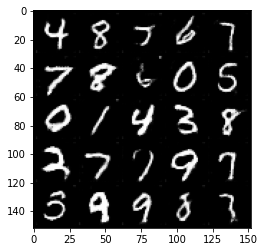

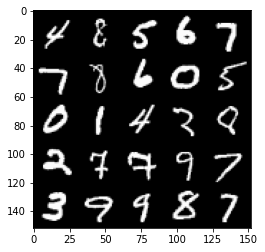

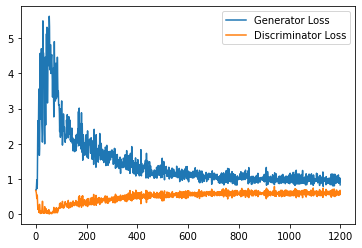

Step 24500: Generator loss: 0.9876572029590607, discriminator loss: 0.602789334833622


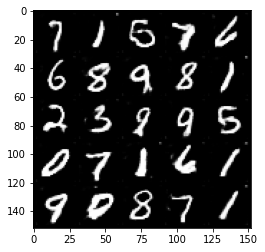

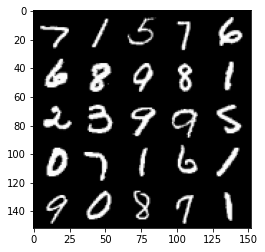

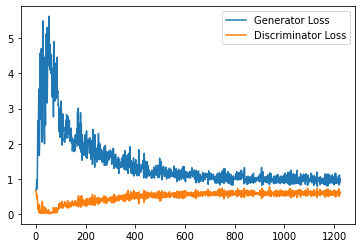

Step 25000: Generator loss: 0.9841735465526581, discriminator loss: 0.6043379163146019


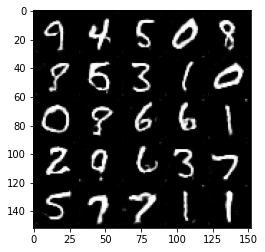

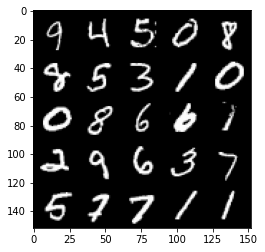

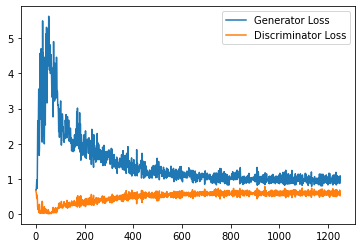

Step 25500: Generator loss: 0.9635088782310486, discriminator loss: 0.6057693780064582


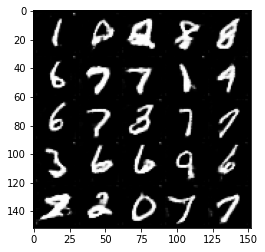

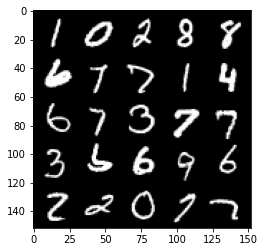

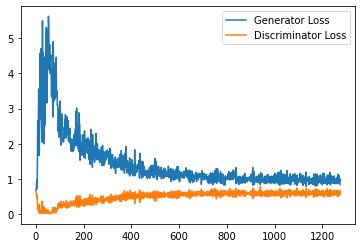

Step 26000: Generator loss: 0.9706167026758193, discriminator loss: 0.6017839263677597


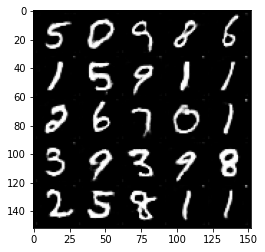

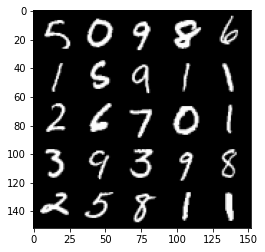

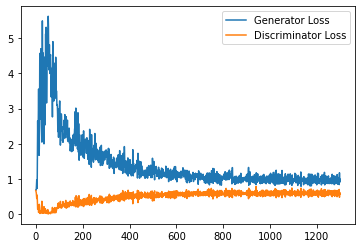

Step 26500: Generator loss: 0.9841737480163574, discriminator loss: 0.6036048799157142


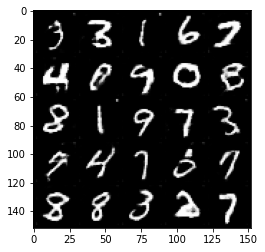

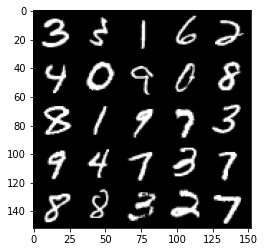

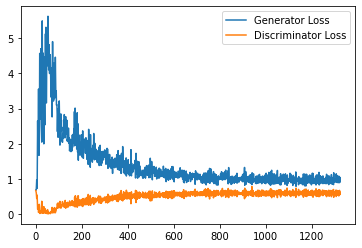

Step 27000: Generator loss: 0.9980050514936447, discriminator loss: 0.5991928306818008


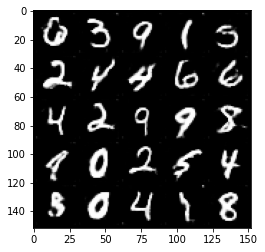

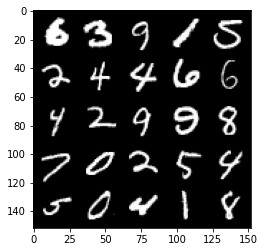

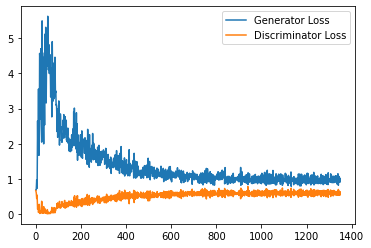

Step 27500: Generator loss: 0.9689114353656769, discriminator loss: 0.6019013178944588


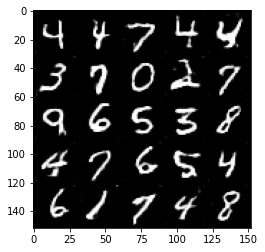

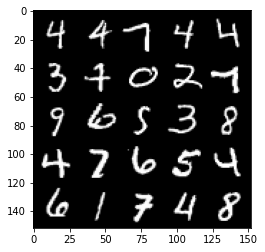

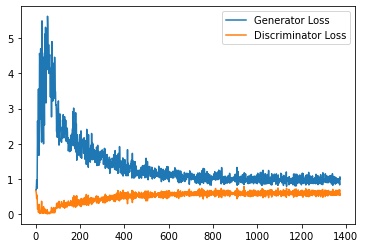

Step 28000: Generator loss: 0.9566236897706986, discriminator loss: 0.6042366529107094


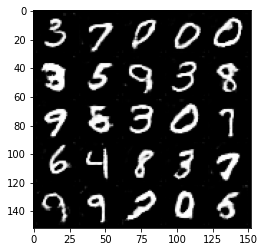

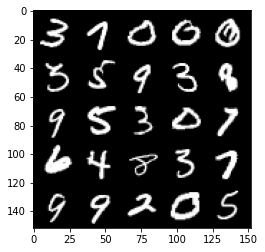

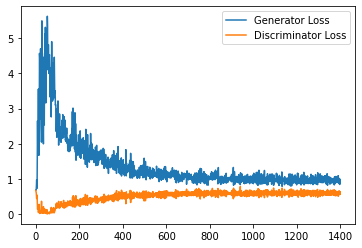

Step 28500: Generator loss: 0.9839458045959473, discriminator loss: 0.5993322986364364


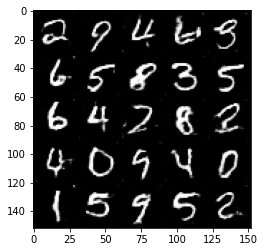

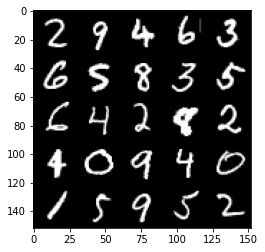

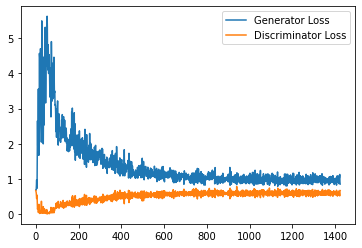

Step 29000: Generator loss: 1.0004919843673705, discriminator loss: 0.597146571457386


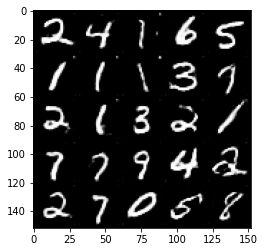

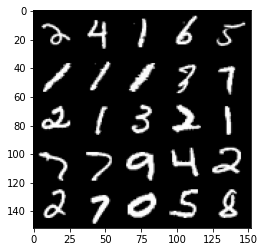

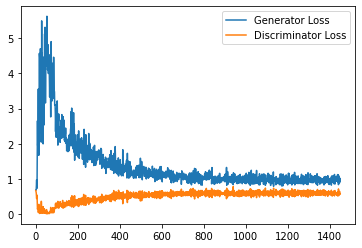

Step 29500: Generator loss: 0.9774269226789475, discriminator loss: 0.5980640987753868


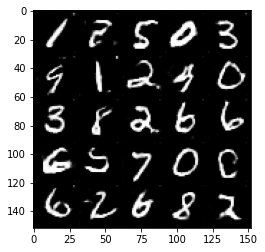

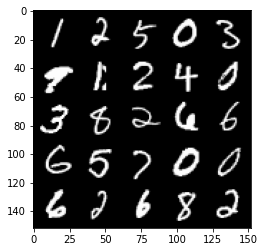

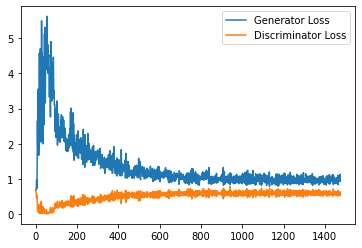

Step 30000: Generator loss: 0.9952366288900375, discriminator loss: 0.605897675037384


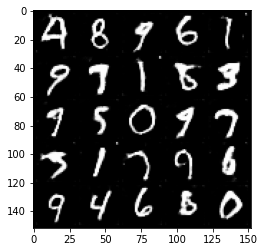

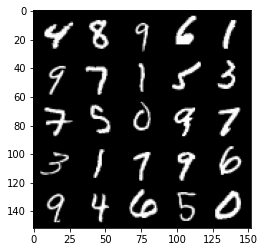

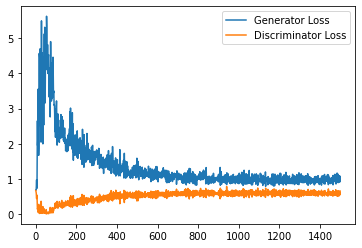

Step 30500: Generator loss: 1.0041599045991898, discriminator loss: 0.5968197548985481


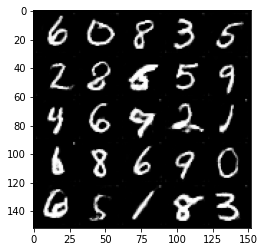

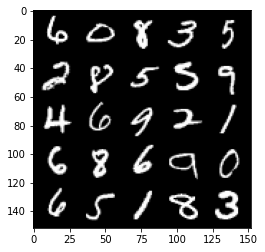

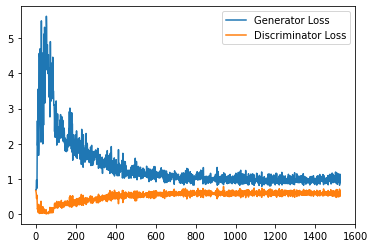

Step 31000: Generator loss: 0.9842761319875717, discriminator loss: 0.6010219468474388


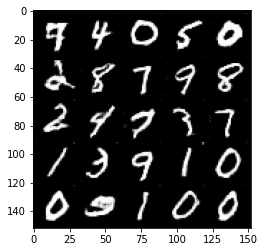

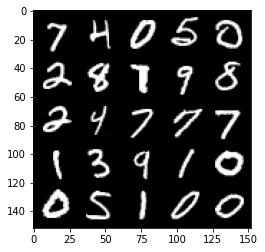

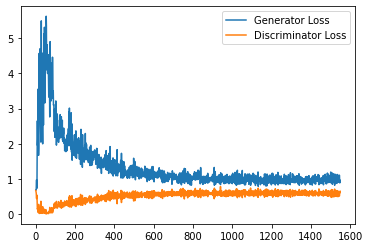

Step 31500: Generator loss: 0.9741723508834839, discriminator loss: 0.6001065348386765


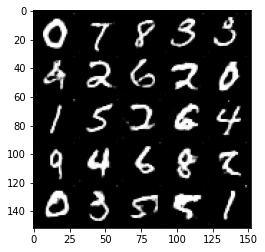

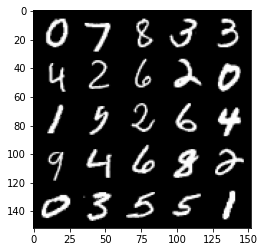

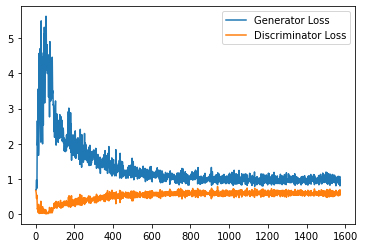

Step 32000: Generator loss: 0.9848991218805313, discriminator loss: 0.5976446390748024


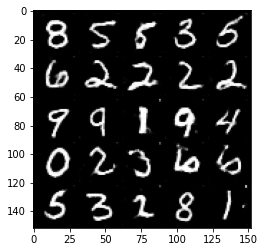

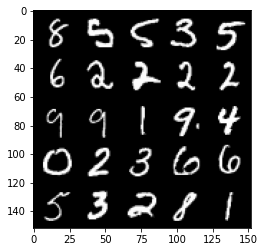

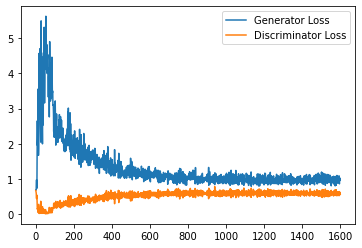

Step 32500: Generator loss: 0.9762246466875076, discriminator loss: 0.6036378497481346


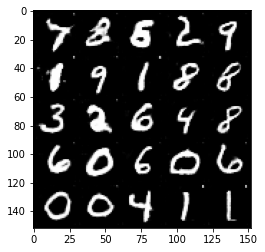

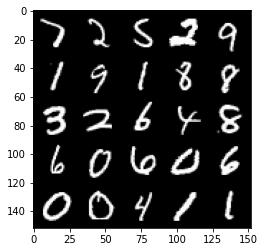

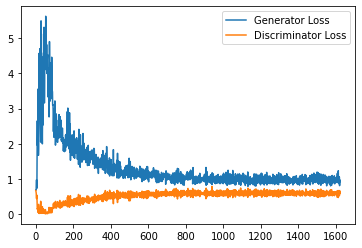

Step 33000: Generator loss: 0.9738561911582947, discriminator loss: 0.5936356844902039


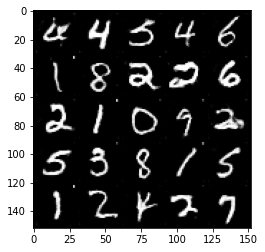

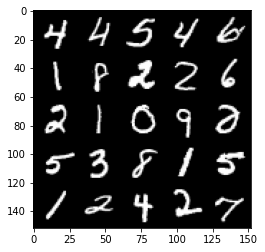

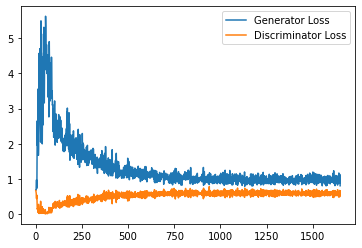

Step 33500: Generator loss: 0.9707135993242264, discriminator loss: 0.5955833313465119


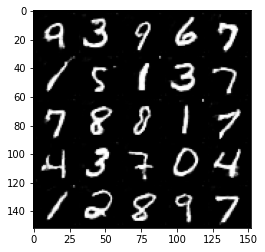

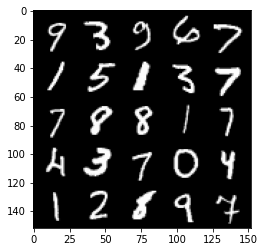

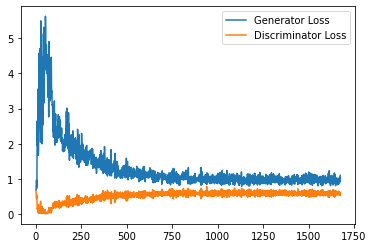

Step 34000: Generator loss: 0.9857587349414826, discriminator loss: 0.5968081105351448


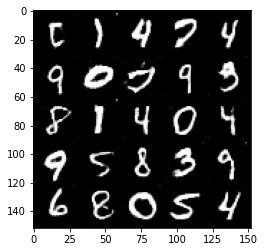

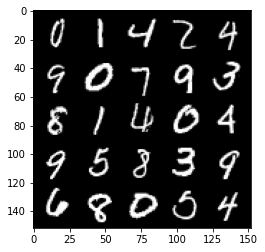

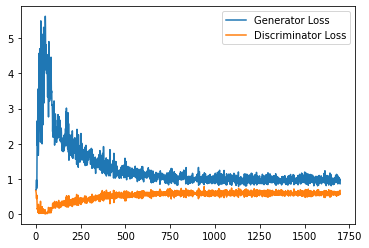

Step 34500: Generator loss: 0.9952324800491333, discriminator loss: 0.5910620750188827


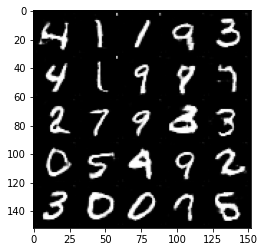

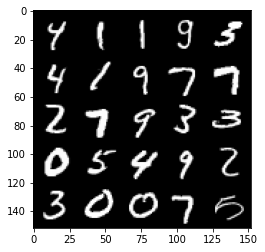

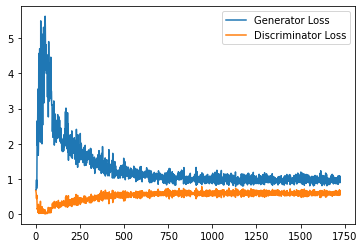

Step 35000: Generator loss: 1.006044487595558, discriminator loss: 0.5936221553683281


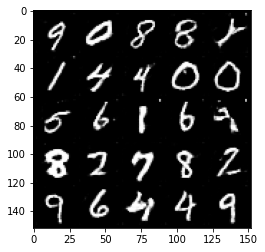

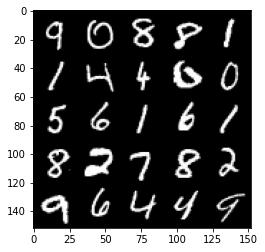

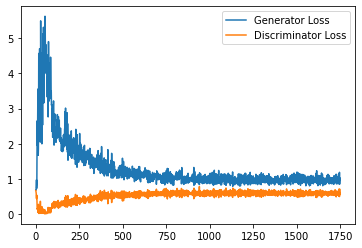

Step 35500: Generator loss: 0.9785985575914383, discriminator loss: 0.595824013710022


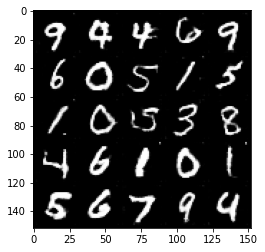

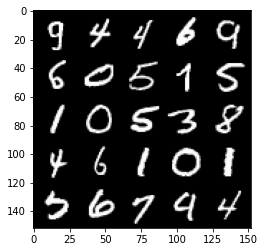

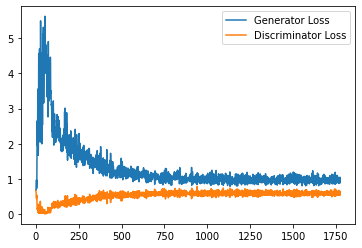

Step 36000: Generator loss: 0.9896886297464371, discriminator loss: 0.5907960029244423


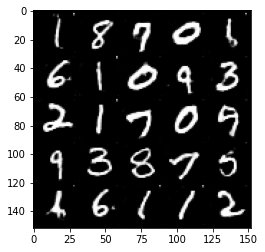

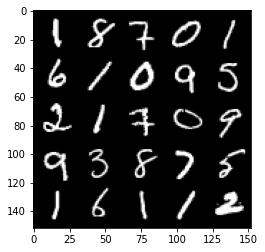

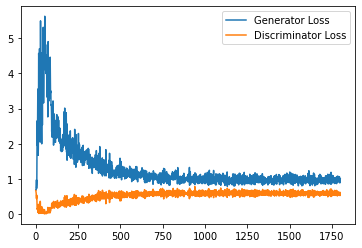

Step 36500: Generator loss: 0.973872763633728, discriminator loss: 0.5928974452614785


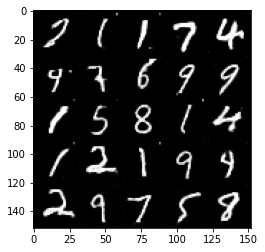

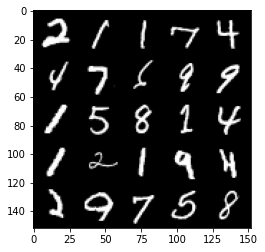

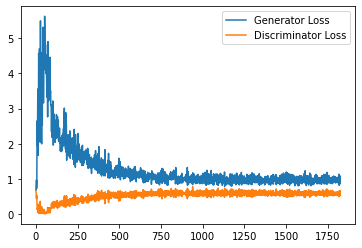

Step 37000: Generator loss: 0.9849945431947709, discriminator loss: 0.5884339951276779


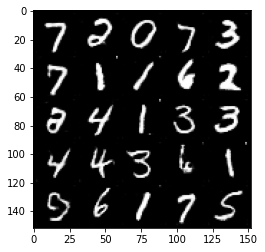

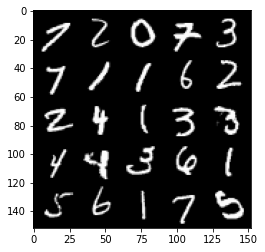

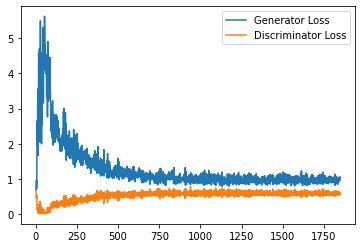

Step 37500: Generator loss: 0.998989305973053, discriminator loss: 0.5883298920989036


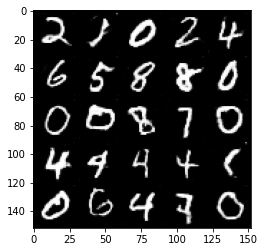

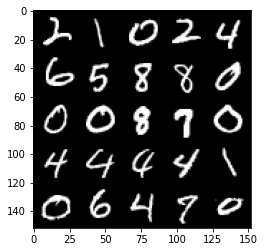

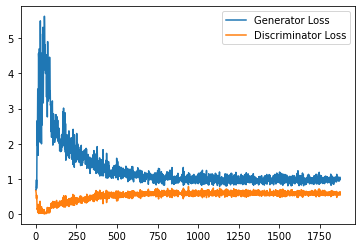

Step 38000: Generator loss: 0.994392760515213, discriminator loss: 0.590500607073307


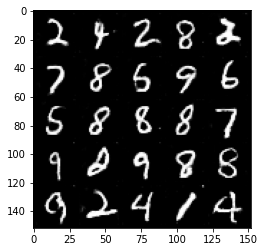

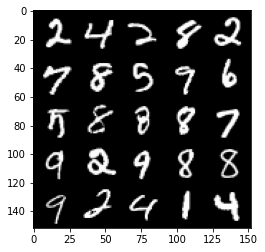

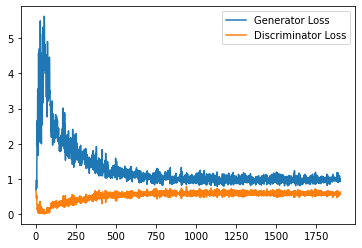

Step 38500: Generator loss: 0.9805258499383926, discriminator loss: 0.5880077099204063


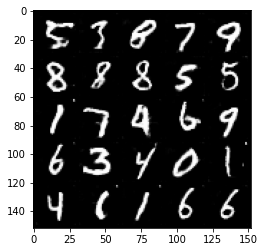

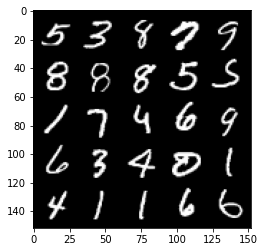

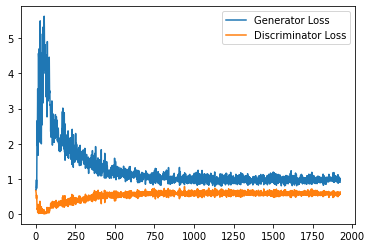

Step 39000: Generator loss: 0.9974877933263778, discriminator loss: 0.584608852505684


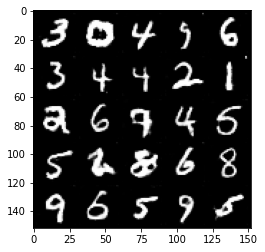

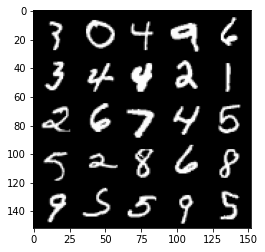

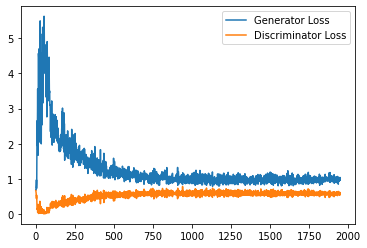

Step 39500: Generator loss: 1.011156092762947, discriminator loss: 0.585356792807579


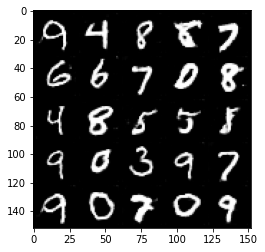

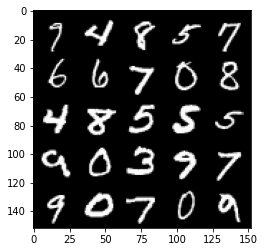

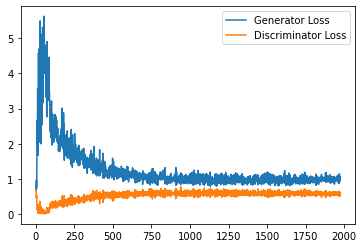

Step 40000: Generator loss: 1.0227349677085877, discriminator loss: 0.5864729756116867


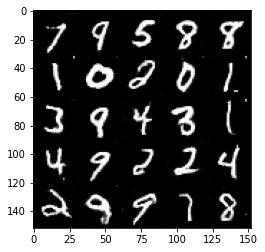

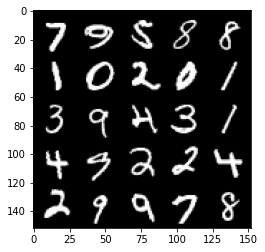

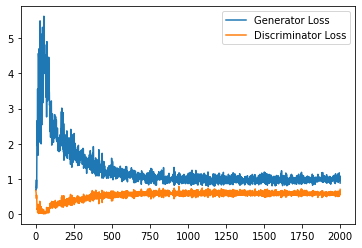

Step 40500: Generator loss: 1.026979689836502, discriminator loss: 0.5816202274560929


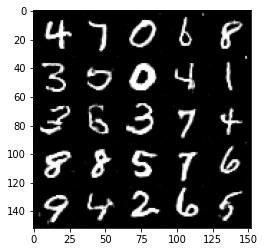

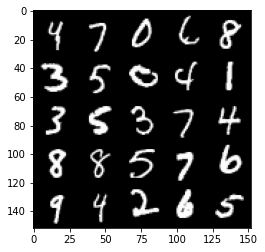

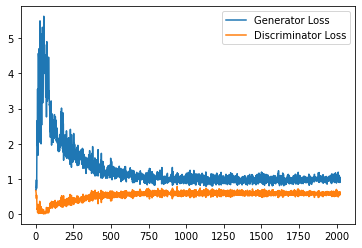

Step 41000: Generator loss: 1.0182408514022827, discriminator loss: 0.5833979657888413


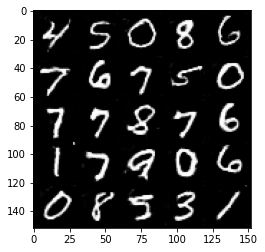

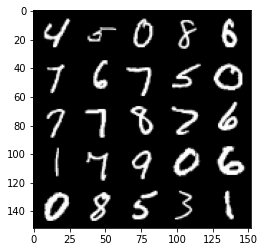

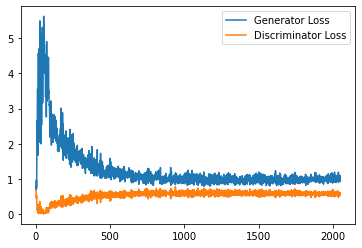

Step 41500: Generator loss: 1.0230890471935272, discriminator loss: 0.5806717099547386


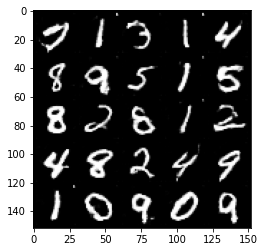

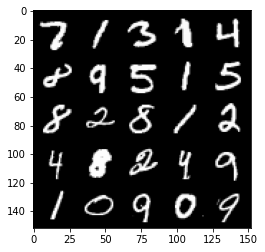

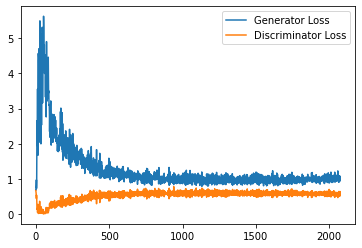

Step 42000: Generator loss: 1.0211171793937683, discriminator loss: 0.584883342564106


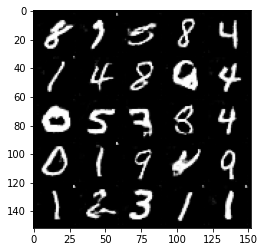

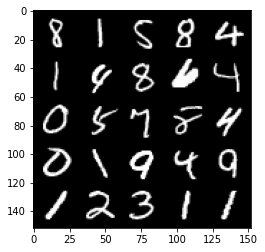

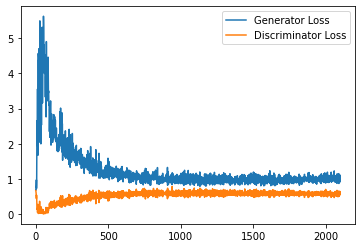

Step 42500: Generator loss: 1.0281907114982605, discriminator loss: 0.5772702701687813


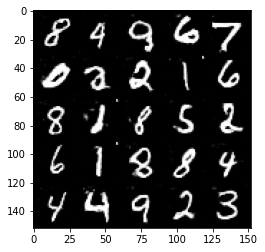

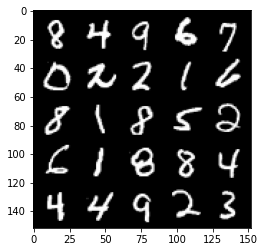

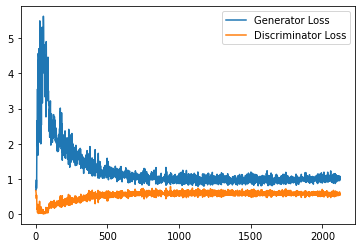

Step 43000: Generator loss: 1.0162833197116852, discriminator loss: 0.5828091008067131


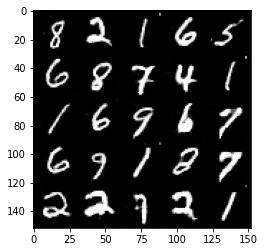

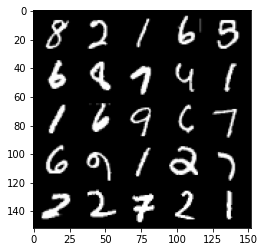

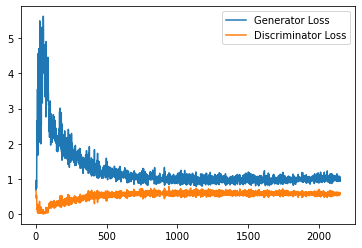

Step 43500: Generator loss: 1.0333674412965774, discriminator loss: 0.5768685876727104


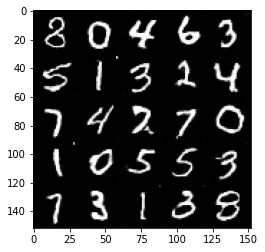

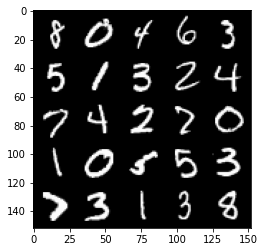

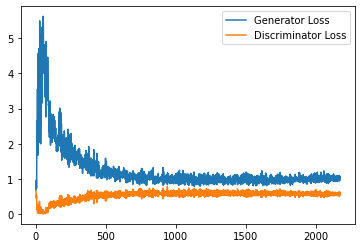

Step 44000: Generator loss: 1.0315933945178986, discriminator loss: 0.5775795500278473


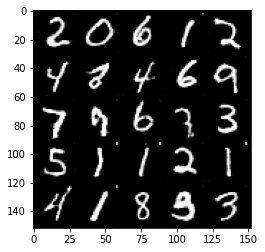

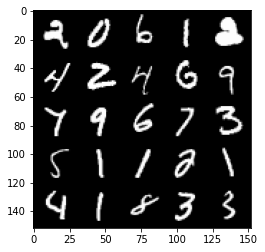

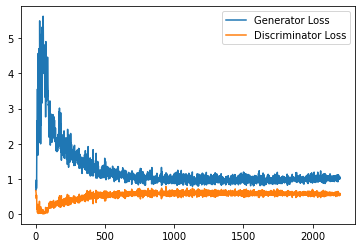

Step 44500: Generator loss: 1.040739768743515, discriminator loss: 0.5792525525093078


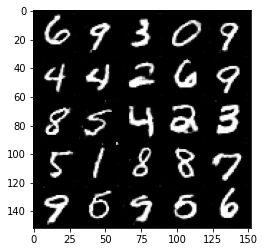

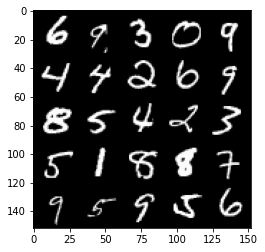

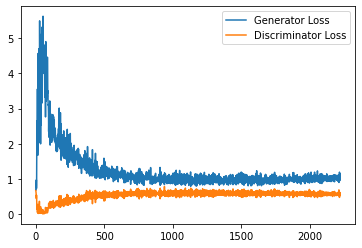

Step 45000: Generator loss: 1.0460685174465179, discriminator loss: 0.5810236841440201


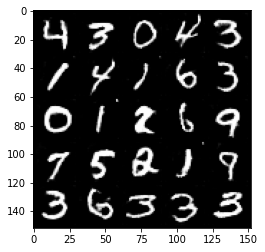

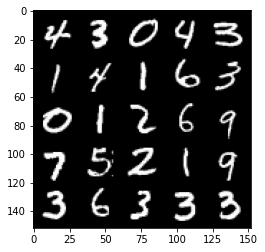

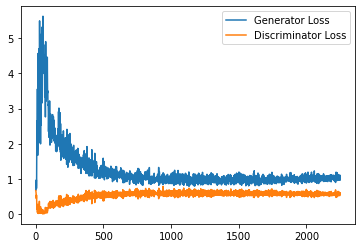

Step 45500: Generator loss: 1.050171762228012, discriminator loss: 0.5773001647591591


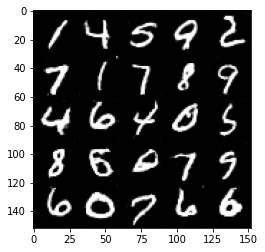

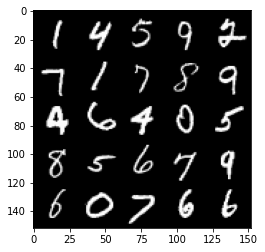

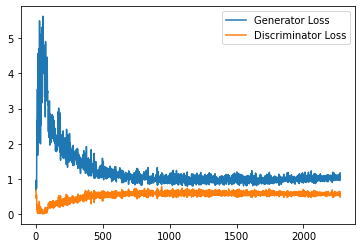

Step 46000: Generator loss: 1.0531833639144899, discriminator loss: 0.5767041693925857


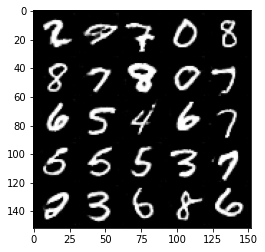

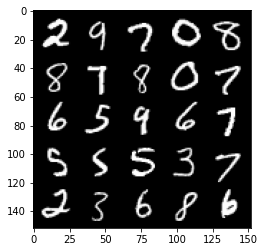

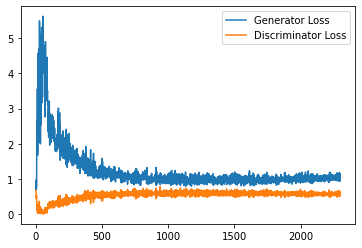

Step 46500: Generator loss: 1.034184711575508, discriminator loss: 0.5707912257909775


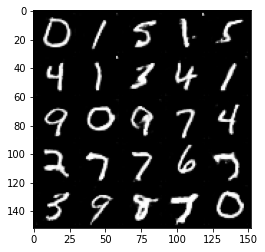

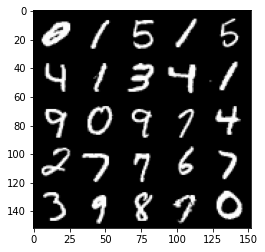

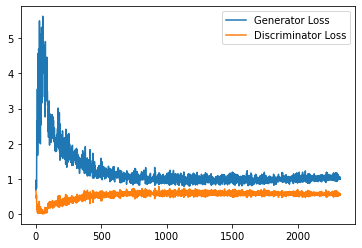

Step 47000: Generator loss: 1.0357466236352921, discriminator loss: 0.5748316578269005


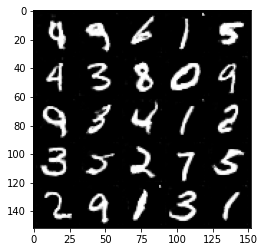

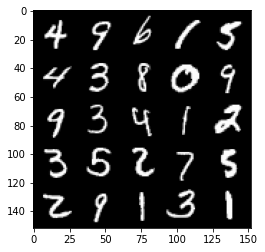

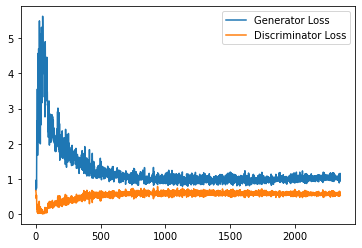

Step 47500: Generator loss: 1.0581627727746963, discriminator loss: 0.5703270614147187


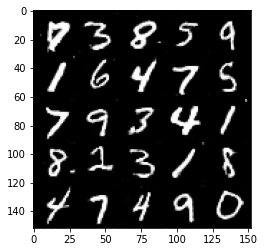

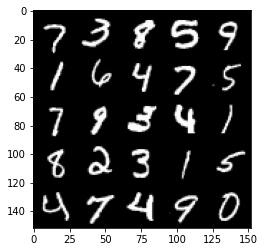

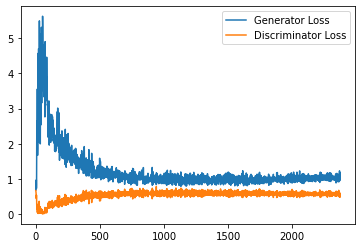

Step 48000: Generator loss: 1.049128732562065, discriminator loss: 0.5777254059910775


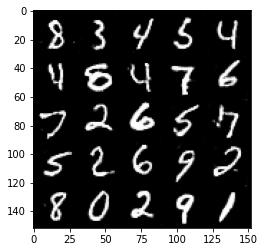

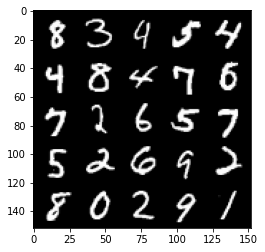

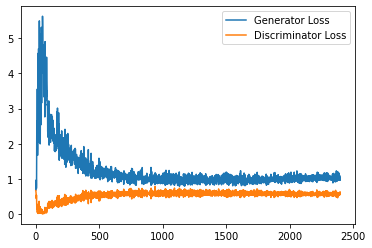

Step 48500: Generator loss: 1.0425798246860505, discriminator loss: 0.5714811166524887


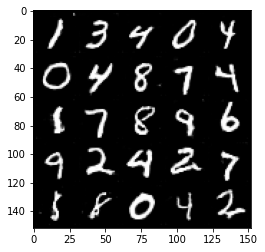

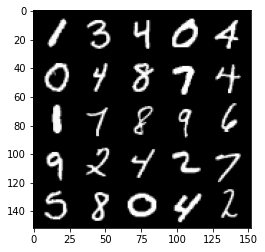

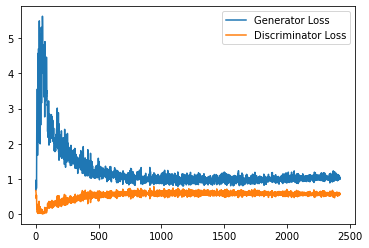

Step 49000: Generator loss: 1.0665098145008087, discriminator loss: 0.5652666973471642


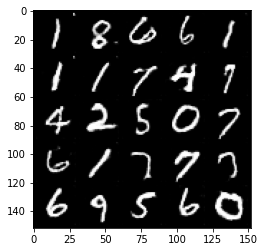

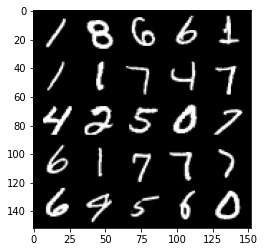

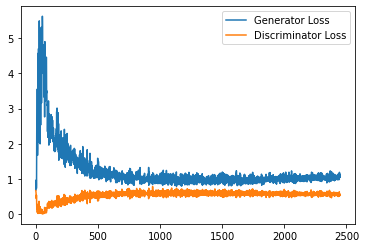

Step 49500: Generator loss: 1.0495662913322448, discriminator loss: 0.5680242758989335


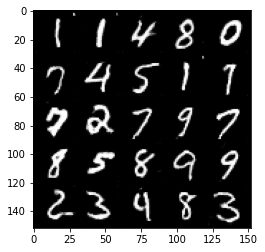

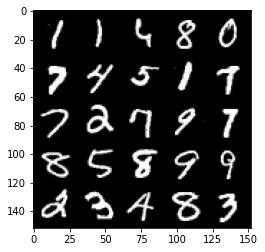

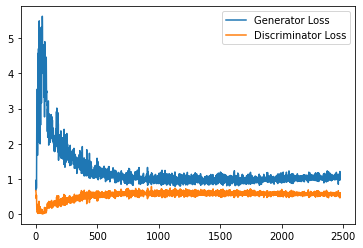

Step 50000: Generator loss: 1.0610125648975373, discriminator loss: 0.5673165529966354


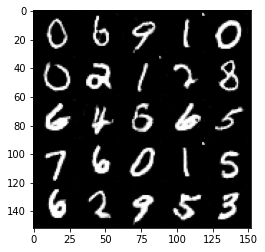

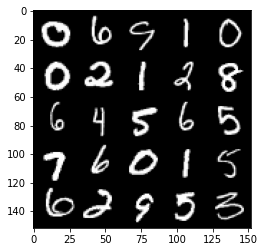

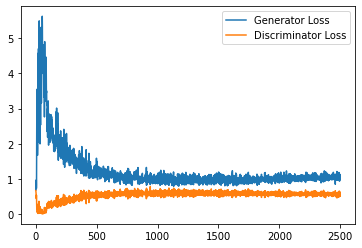

Step 50500: Generator loss: 1.0598399640321732, discriminator loss: 0.5739642165899277


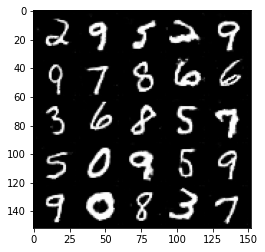

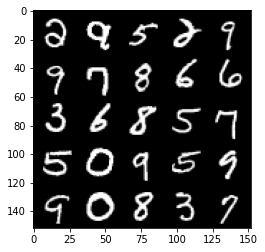

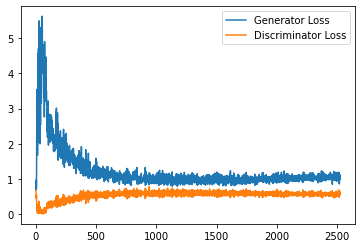

Step 51000: Generator loss: 1.0510212926864624, discriminator loss: 0.571486791074276


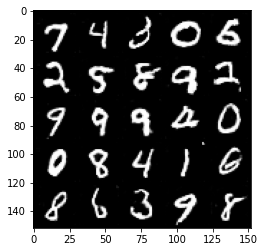

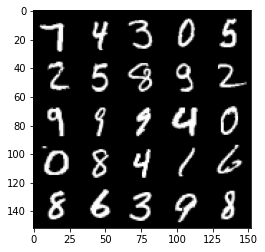

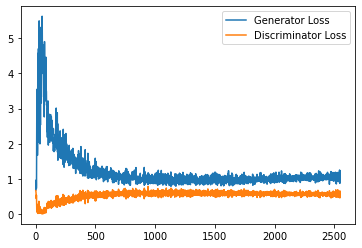

Step 51500: Generator loss: 1.0508096356391907, discriminator loss: 0.5693565427660942


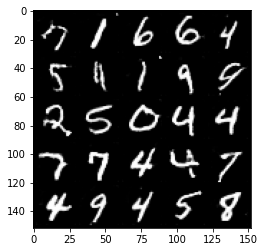

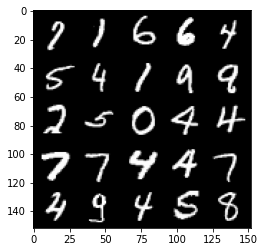

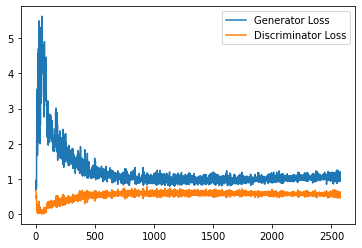

Step 52000: Generator loss: 1.0591576654911041, discriminator loss: 0.5687107883095741


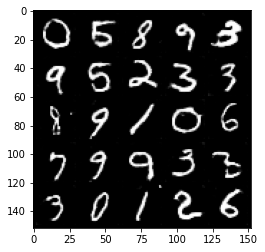

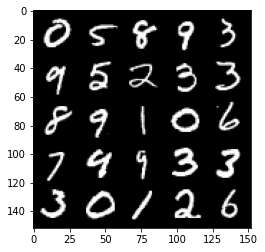

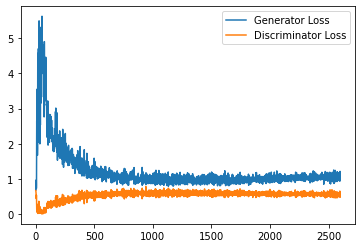

Step 52500: Generator loss: 1.0566538021564484, discriminator loss: 0.5691811363101006


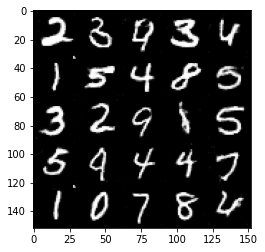

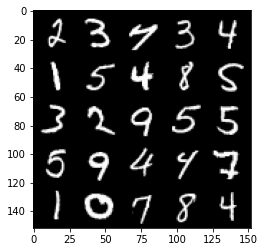

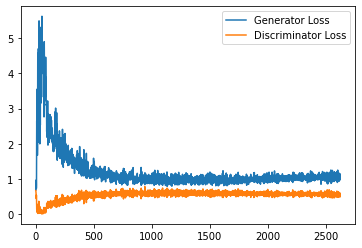

Step 53000: Generator loss: 1.058863523364067, discriminator loss: 0.569849111020565


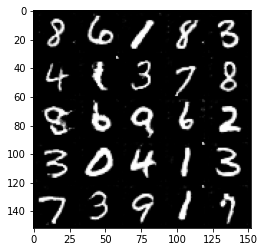

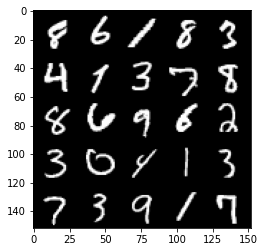

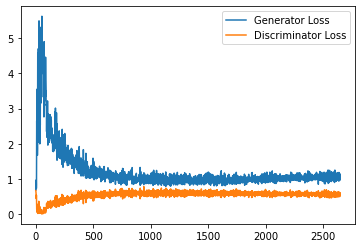

Step 53500: Generator loss: 1.0778434748649597, discriminator loss: 0.5626475324034691


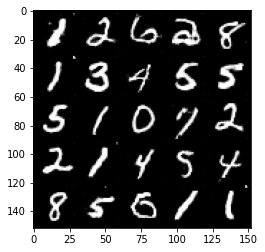

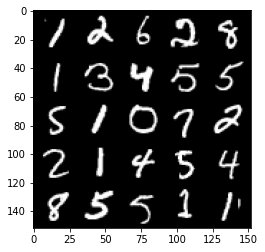

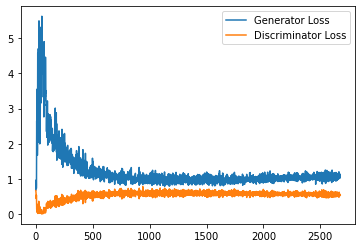

Step 54000: Generator loss: 1.0591640936136246, discriminator loss: 0.5725247173309326


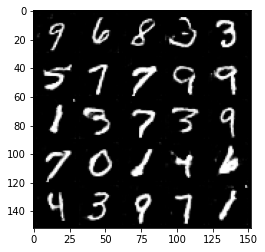

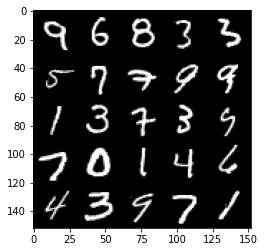

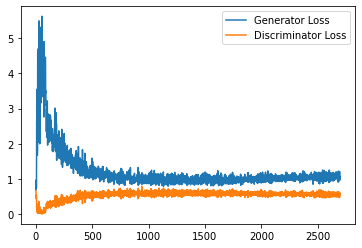

Step 54500: Generator loss: 1.0509510459899902, discriminator loss: 0.5686507577300072


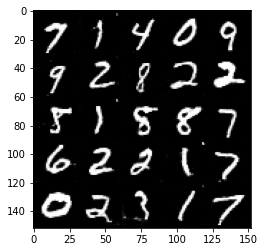

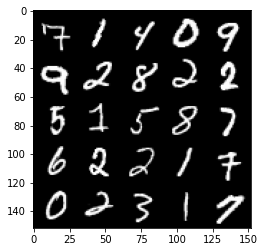

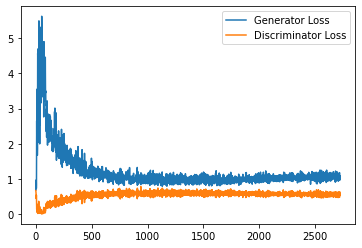

Step 55000: Generator loss: 1.0849440467357636, discriminator loss: 0.5636767572760581


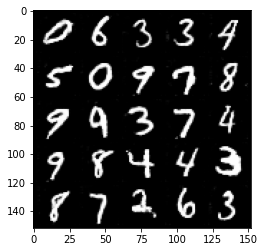

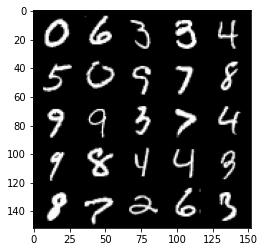

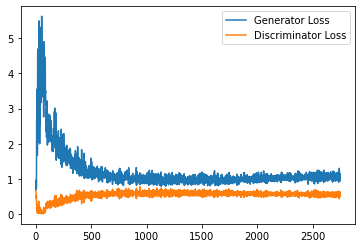

Step 55500: Generator loss: 1.0615232499837874, discriminator loss: 0.5705213680267334


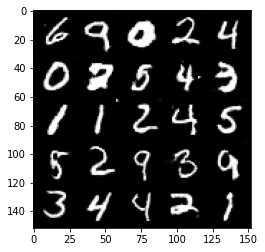

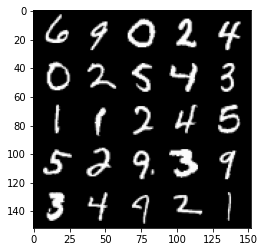

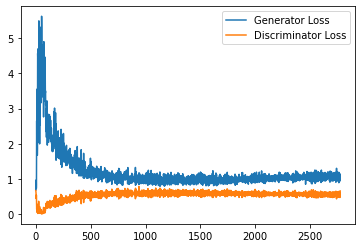

Step 56000: Generator loss: 1.0587989377975464, discriminator loss: 0.5630855438709259


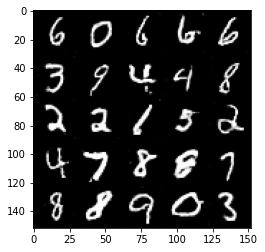

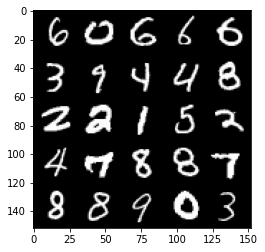

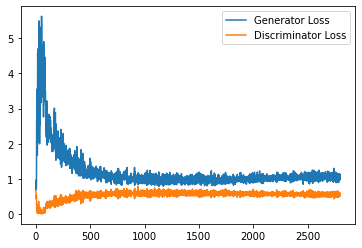

Step 56500: Generator loss: 1.0707140288352965, discriminator loss: 0.5659772539138794


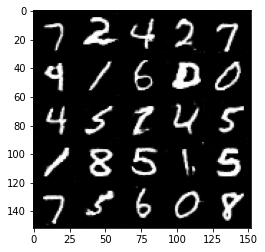

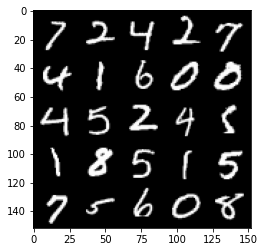

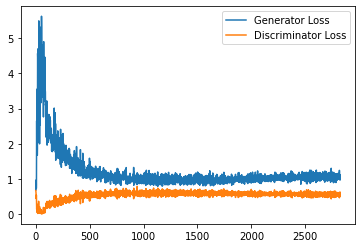

Step 57000: Generator loss: 1.0616236952543259, discriminator loss: 0.564247771024704


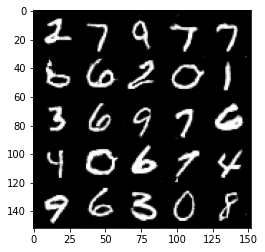

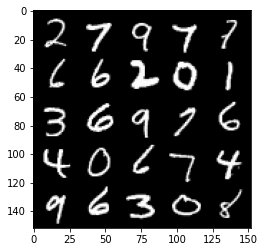

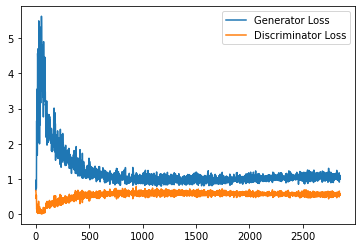

Step 57500: Generator loss: 1.0672562470436096, discriminator loss: 0.5621463914513588


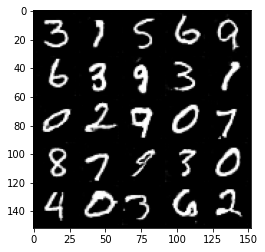

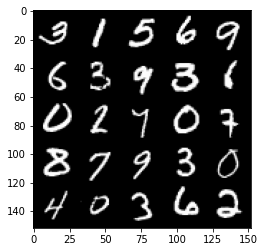

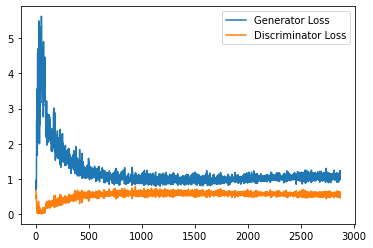

Step 58000: Generator loss: 1.0692326058149337, discriminator loss: 0.5631608745455742


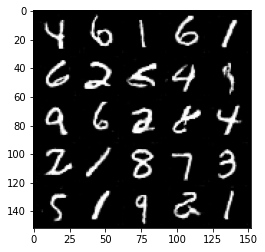

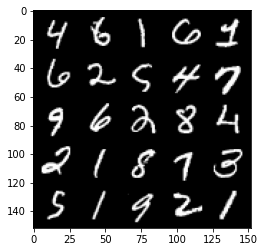

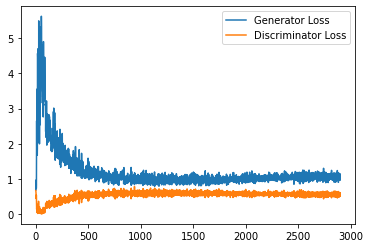

Step 58500: Generator loss: 1.0798533213138581, discriminator loss: 0.564359124660492


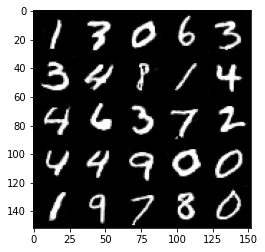

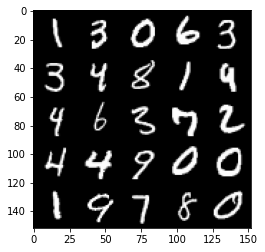

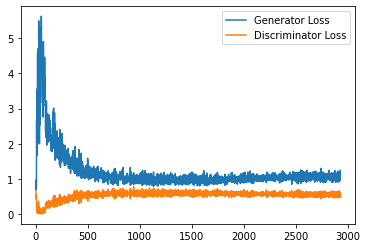

Step 59000: Generator loss: 1.076937113046646, discriminator loss: 0.5639626797437668


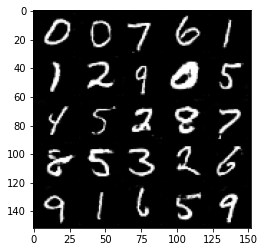

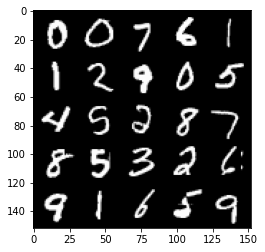

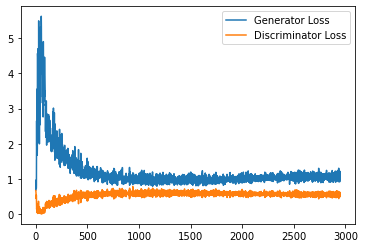

Step 59500: Generator loss: 1.0825660690069199, discriminator loss: 0.5624086155295372


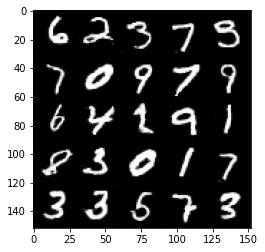

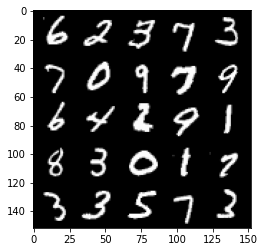

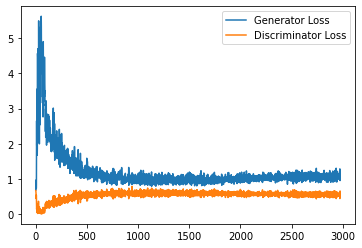

Step 60000: Generator loss: 1.0705408858060836, discriminator loss: 0.5636674432754517


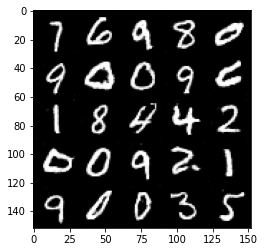

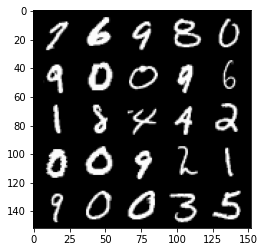

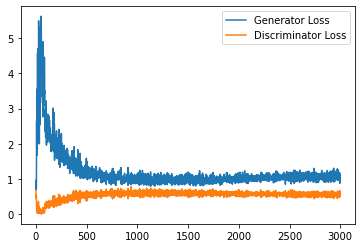

Step 60500: Generator loss: 1.0737280411720276, discriminator loss: 0.5646831713914872


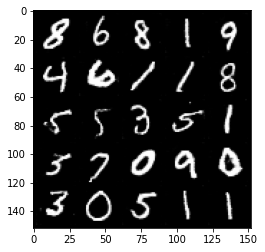

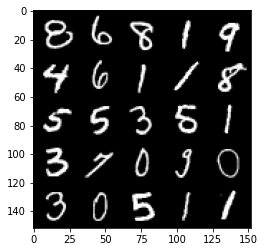

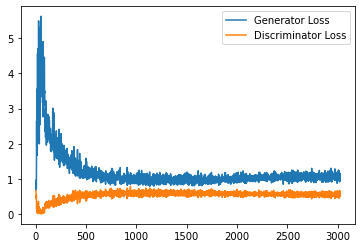

Step 61000: Generator loss: 1.0752317413091659, discriminator loss: 0.5600823813080787


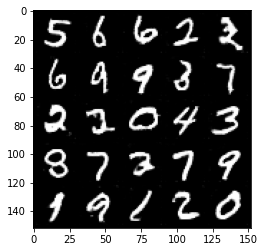

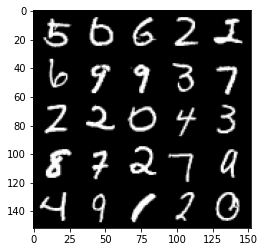

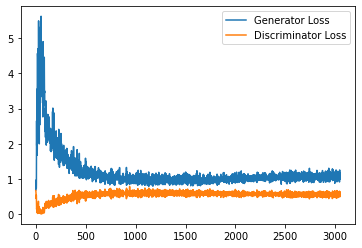

Step 61500: Generator loss: 1.0932978068590165, discriminator loss: 0.5599658949375153


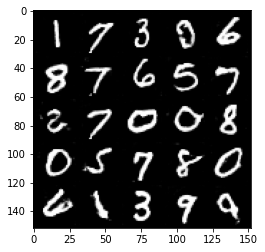

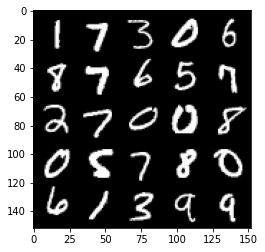

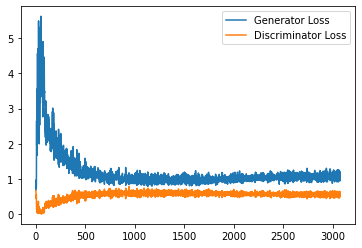

Step 62000: Generator loss: 1.0690509526729584, discriminator loss: 0.5643563496470452


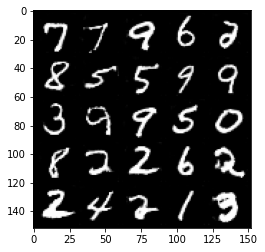

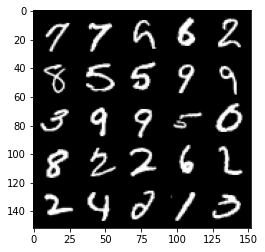

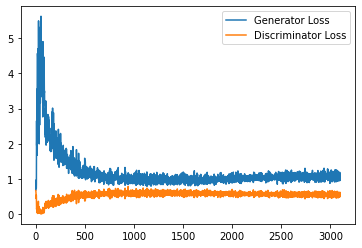

Step 62500: Generator loss: 1.0920178385972976, discriminator loss: 0.5555223099589348


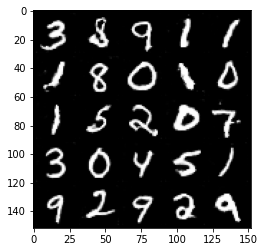

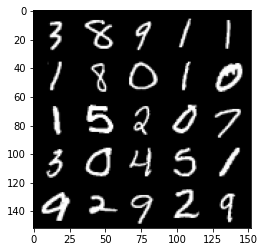

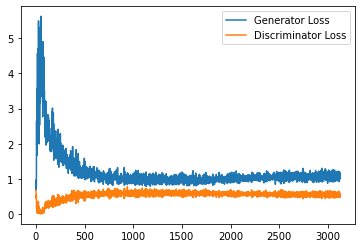

Step 63000: Generator loss: 1.0996445583105088, discriminator loss: 0.5644984964132309


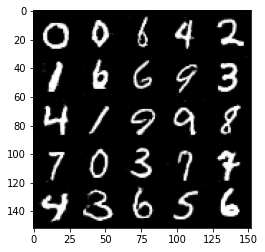

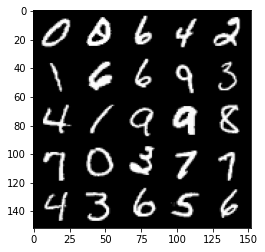

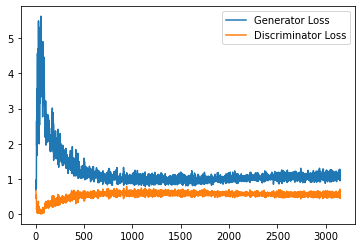

Step 63500: Generator loss: 1.081531926035881, discriminator loss: 0.5561591666340828


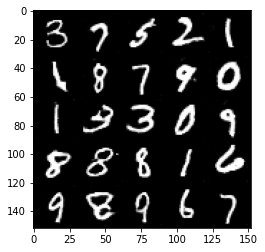

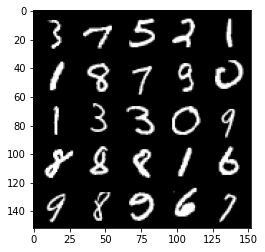

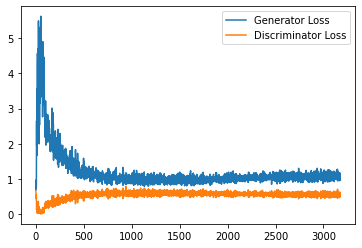

Step 64000: Generator loss: 1.0818789783716203, discriminator loss: 0.561180693089962


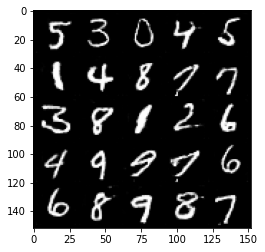

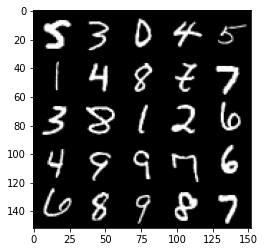

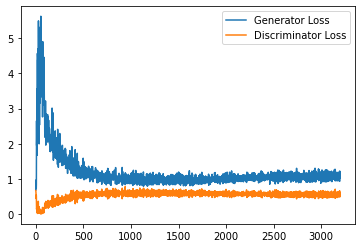

Step 64500: Generator loss: 1.1010161205530167, discriminator loss: 0.5592887864708901


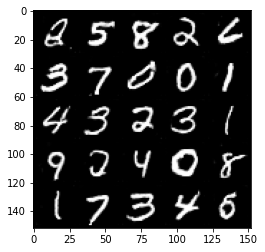

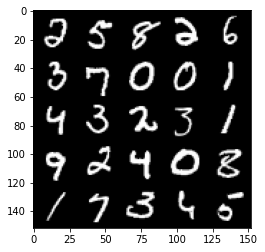

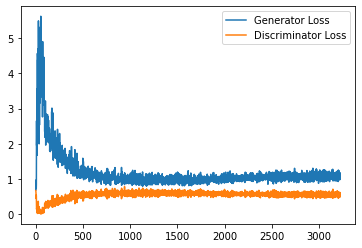

Step 65000: Generator loss: 1.0767861490249633, discriminator loss: 0.5676603466868401


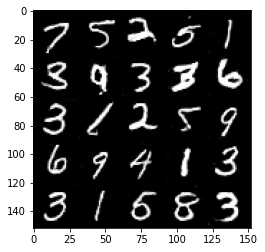

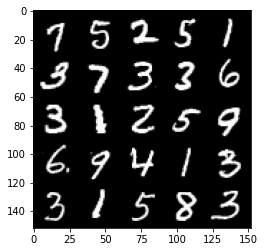

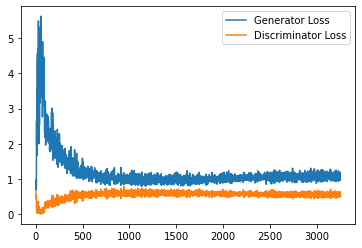

Step 65500: Generator loss: 1.0906589789390564, discriminator loss: 0.562586031973362


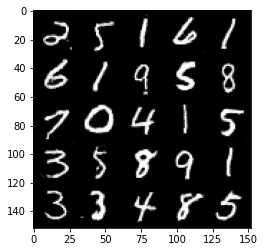

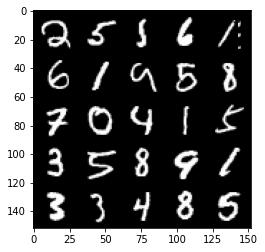

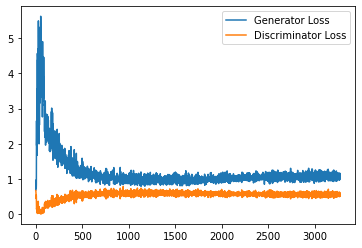

Step 66000: Generator loss: 1.0811327255964278, discriminator loss: 0.5606170652508735


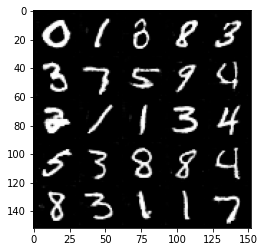

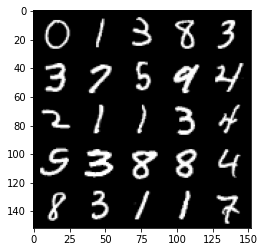

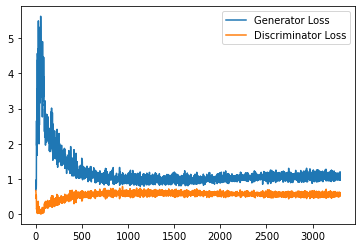

Step 66500: Generator loss: 1.0808060047626495, discriminator loss: 0.5667627947330475


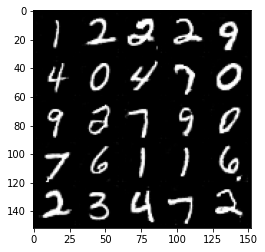

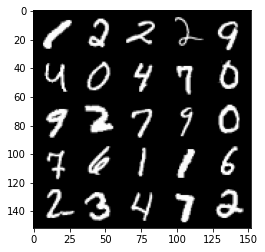

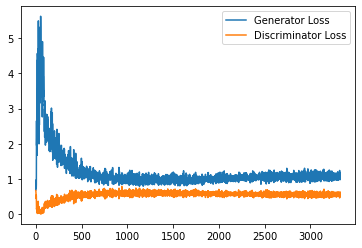

Step 67000: Generator loss: 1.0890109757184983, discriminator loss: 0.5599220433831215


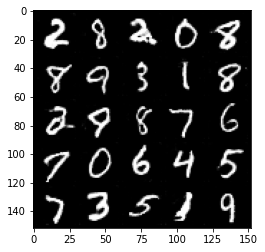

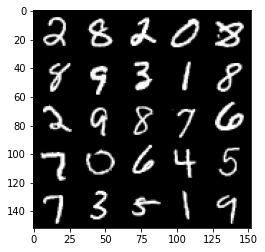

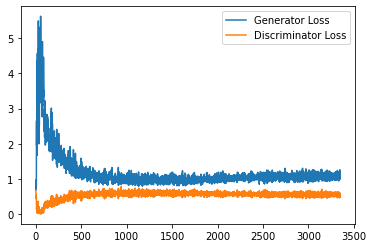

Step 67500: Generator loss: 1.0712842013835906, discriminator loss: 0.5674754368066788


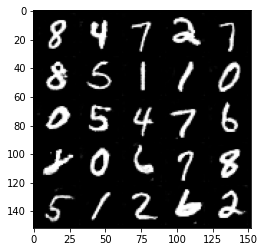

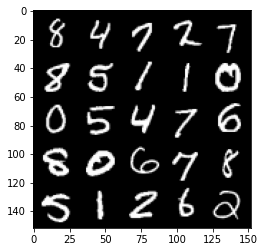

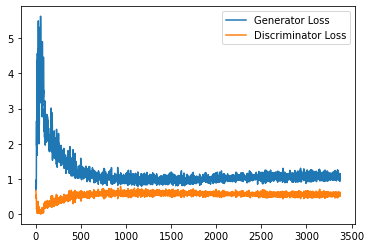

Step 68000: Generator loss: 1.0813194828033448, discriminator loss: 0.5645670489668846


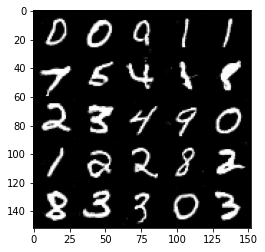

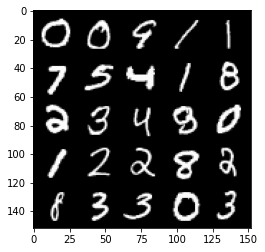

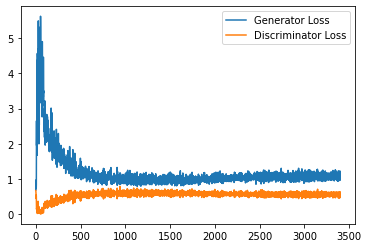

Step 68500: Generator loss: 1.0899351235628127, discriminator loss: 0.559435500562191


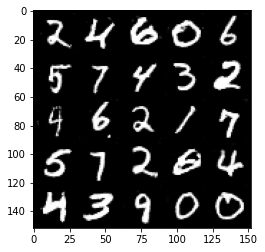

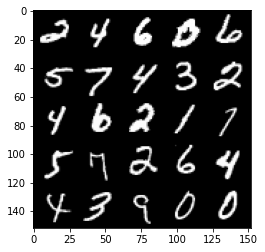

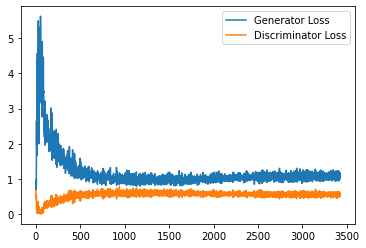

Step 69000: Generator loss: 1.092599218249321, discriminator loss: 0.564491518497467


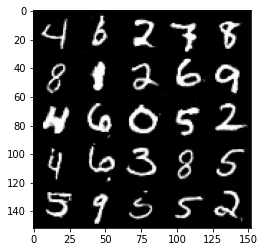

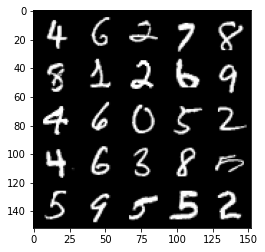

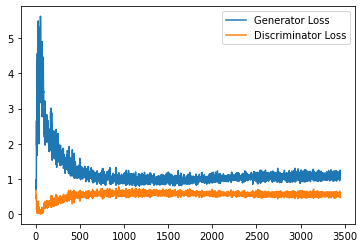

Step 69500: Generator loss: 1.0785652242898942, discriminator loss: 0.5717866607904434


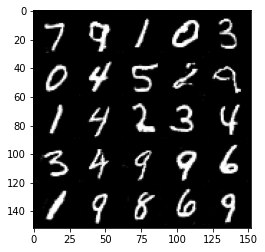

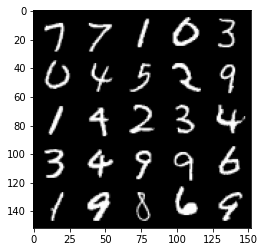

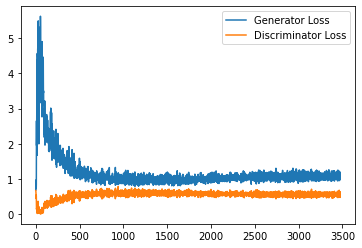

Step 70000: Generator loss: 1.0965348796844483, discriminator loss: 0.5589566918015481


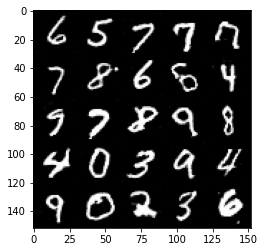

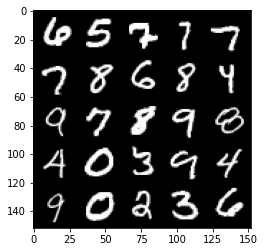

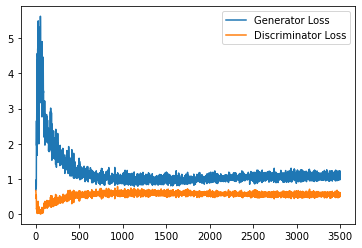

Step 70500: Generator loss: 1.095710478901863, discriminator loss: 0.563755363881588


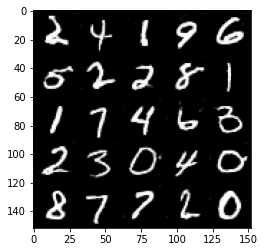

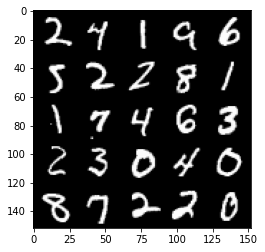

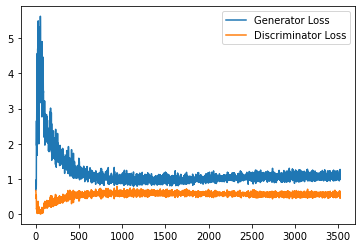

Step 71000: Generator loss: 1.0931877558231353, discriminator loss: 0.5640191593170166


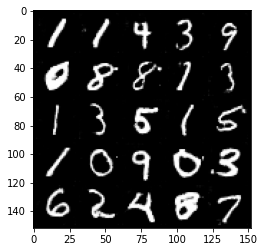

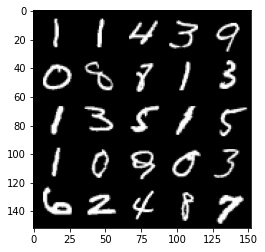

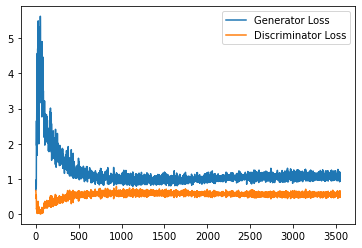

Step 71500: Generator loss: 1.0753693749904634, discriminator loss: 0.5650682842731476


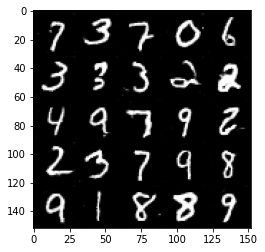

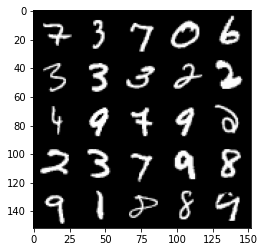

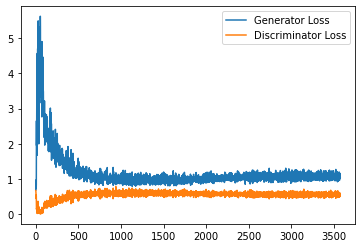

Step 72000: Generator loss: 1.0789240387678147, discriminator loss: 0.5654966119527817


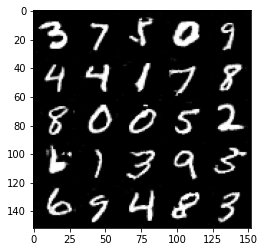

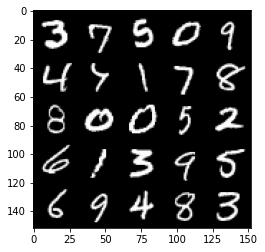

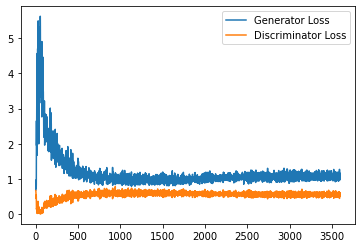

Step 72500: Generator loss: 1.0984731169939042, discriminator loss: 0.5630467640161514


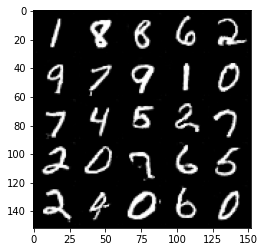

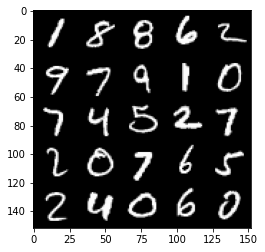

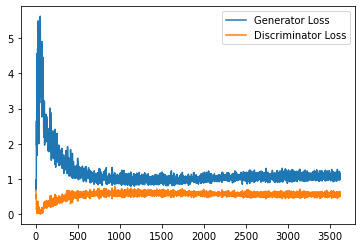

Step 73000: Generator loss: 1.086354479432106, discriminator loss: 0.5629745946526528


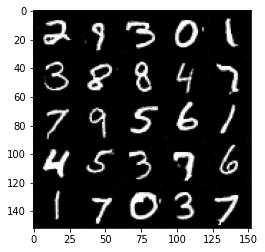

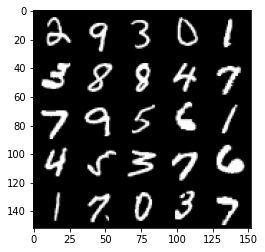

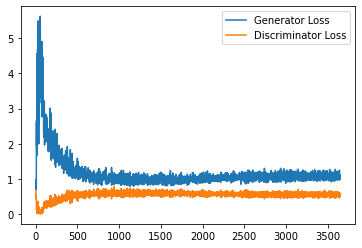

Step 73500: Generator loss: 1.0851201380491258, discriminator loss: 0.564966437637806


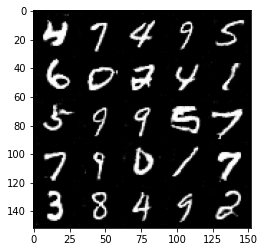

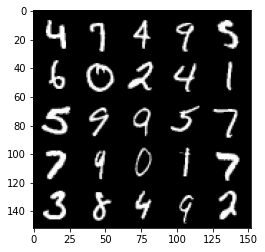

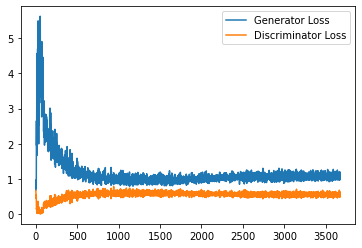

Step 74000: Generator loss: 1.0987318867444993, discriminator loss: 0.5596738146543503


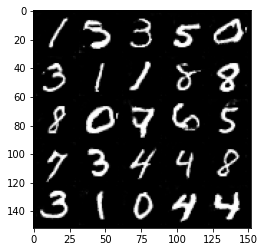

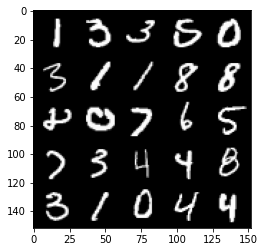

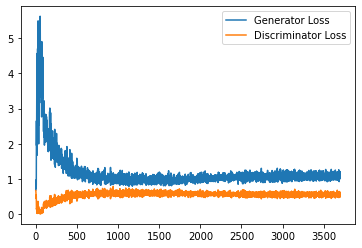

Step 74500: Generator loss: 1.0921004621982575, discriminator loss: 0.5627037390470505


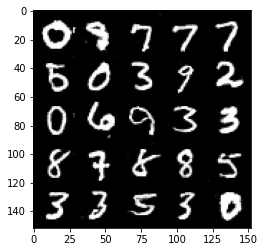

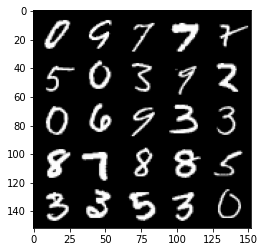

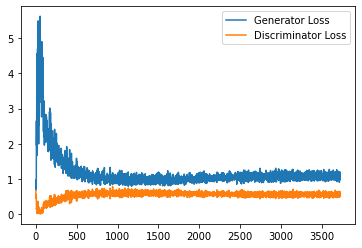

Step 75000: Generator loss: 1.093243458032608, discriminator loss: 0.5653088266253471


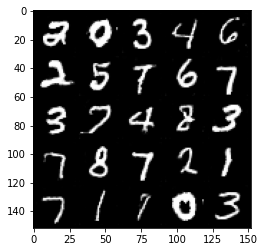

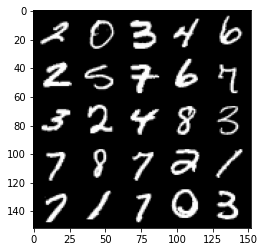

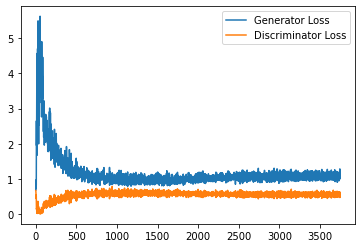

Step 75500: Generator loss: 1.0862579040527345, discriminator loss: 0.5700249570608139


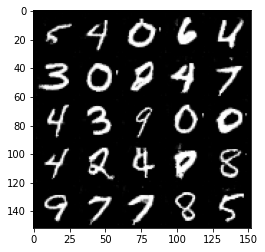

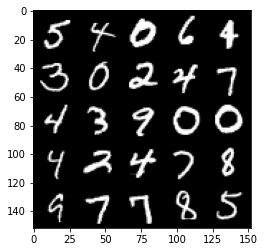

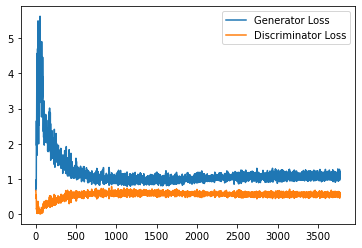

Step 76000: Generator loss: 1.0878748333454131, discriminator loss: 0.5623857264518738


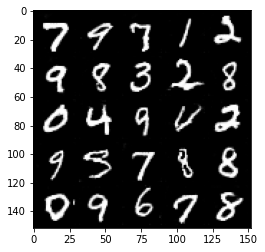

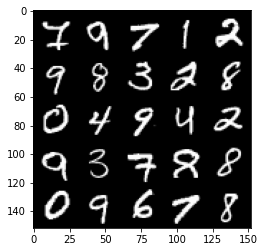

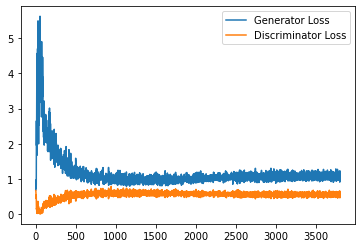

Step 76500: Generator loss: 1.0995411670207977, discriminator loss: 0.5629461867809296


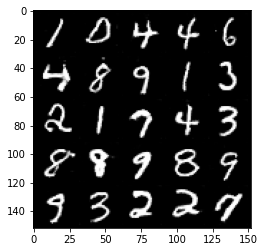

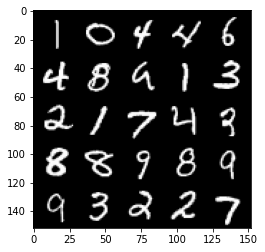

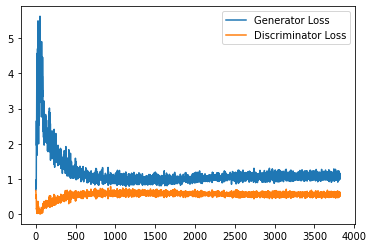

Step 77000: Generator loss: 1.1017313474416732, discriminator loss: 0.5617214130163193


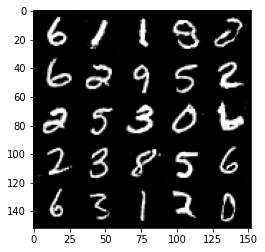

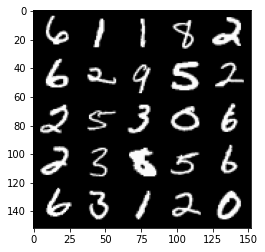

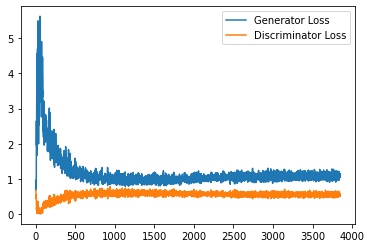

Step 77500: Generator loss: 1.0845270104408264, discriminator loss: 0.5635822057127953


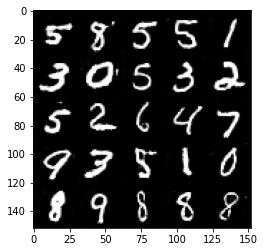

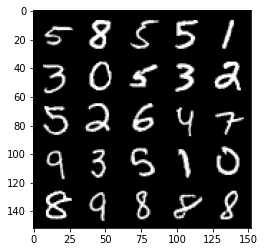

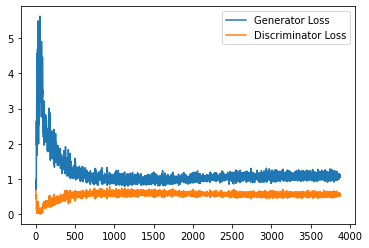

Step 78000: Generator loss: 1.089152534365654, discriminator loss: 0.5654148197770119


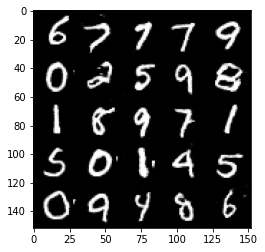

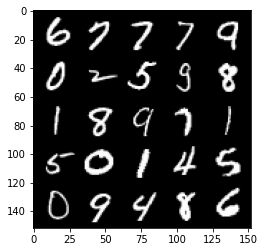

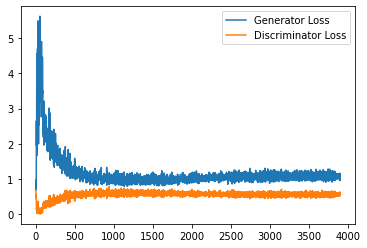

Step 78500: Generator loss: 1.0923358023166656, discriminator loss: 0.5616629256606102


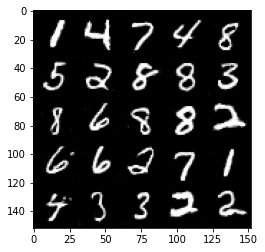

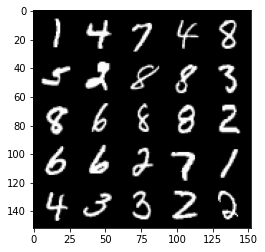

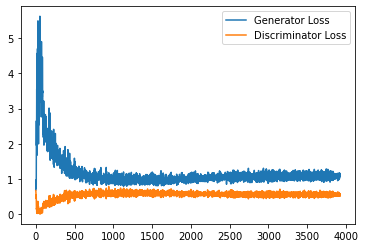

Step 79000: Generator loss: 1.0847022576332093, discriminator loss: 0.5613939692378044


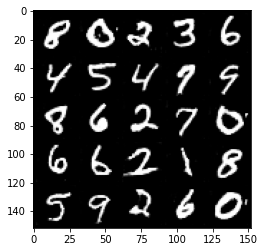

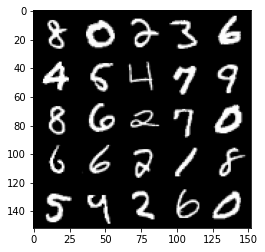

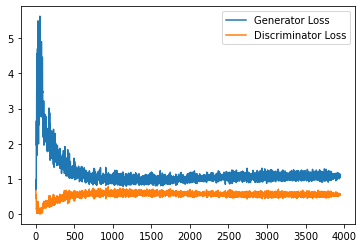

Step 79500: Generator loss: 1.0928125672340394, discriminator loss: 0.5605511971712113


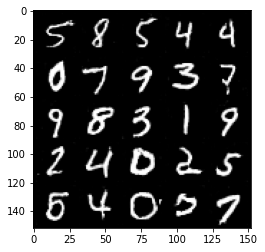

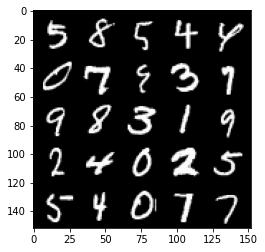

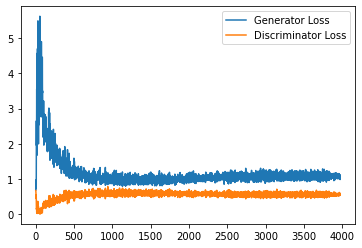

Step 80000: Generator loss: 1.1085758240222932, discriminator loss: 0.5621212181448937


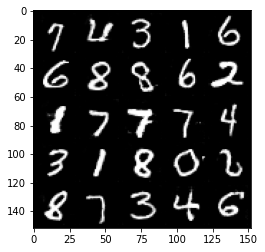

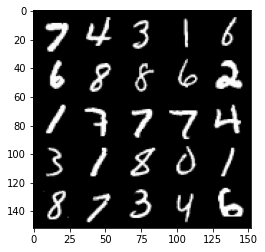

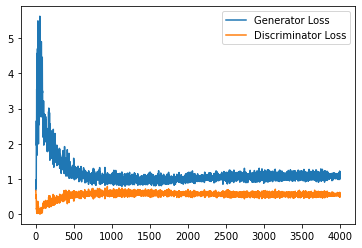

Step 80500: Generator loss: 1.1060988854169846, discriminator loss: 0.5607974308133126


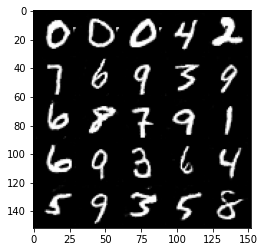

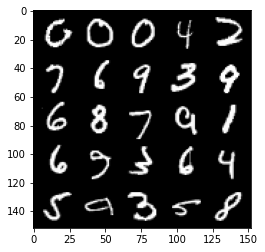

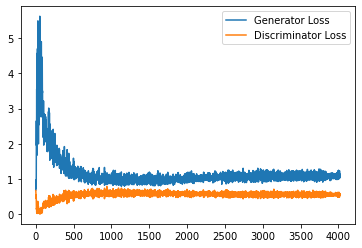

Step 81000: Generator loss: 1.1102215690612793, discriminator loss: 0.5670245846509934


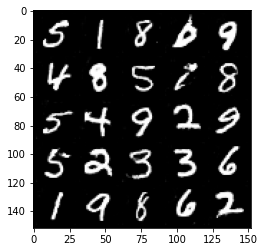

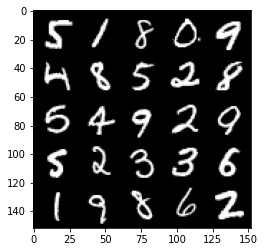

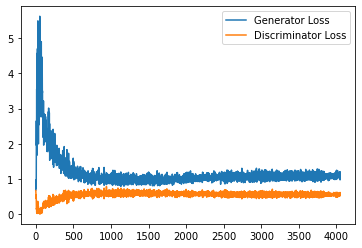

Step 81500: Generator loss: 1.098137216091156, discriminator loss: 0.5642015380263329


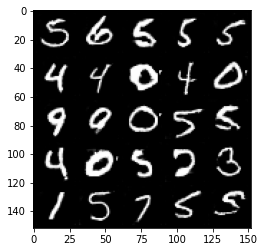

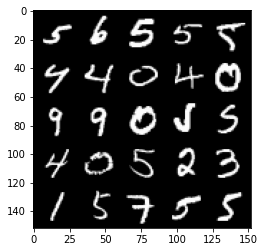

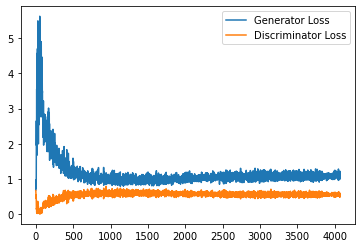

Step 82000: Generator loss: 1.0758725861310958, discriminator loss: 0.5675444923043251


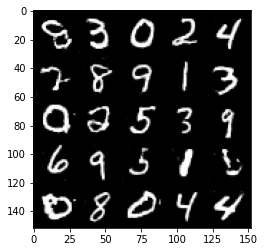

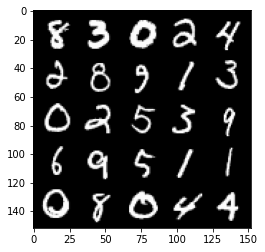

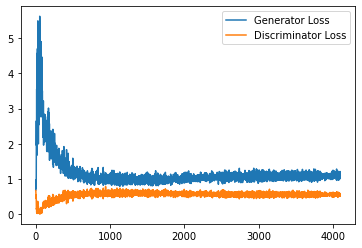

Step 82500: Generator loss: 1.0815608893632889, discriminator loss: 0.5670801650285721


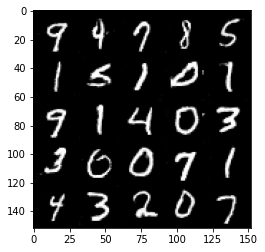

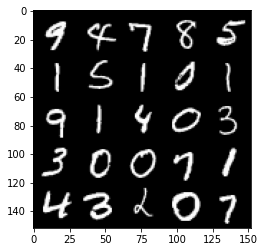

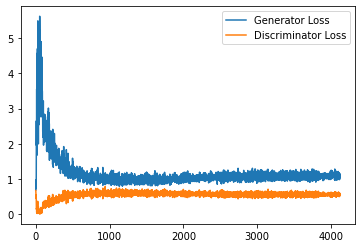

Step 83000: Generator loss: 1.0833130847215653, discriminator loss: 0.5641807506084442


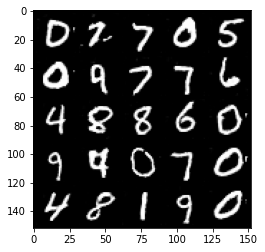

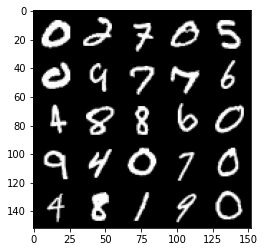

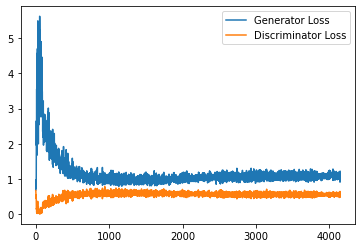

Step 83500: Generator loss: 1.0891994607448579, discriminator loss: 0.5728909833431244


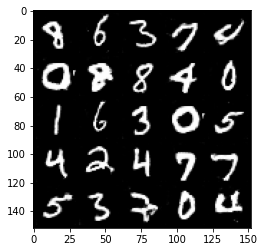

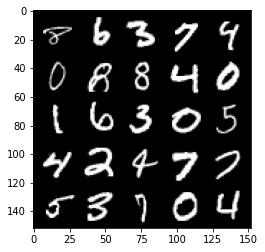

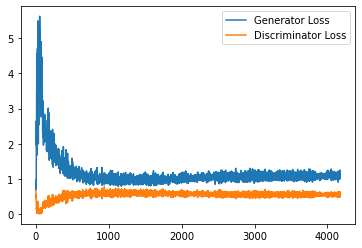

Step 84000: Generator loss: 1.1020940536260604, discriminator loss: 0.5660264862775802


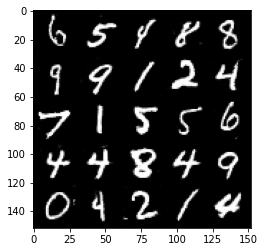

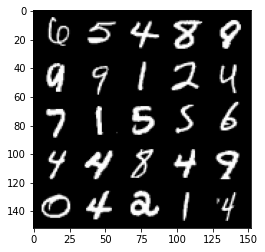

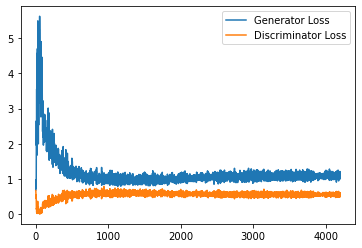

Step 84500: Generator loss: 1.0838820821046828, discriminator loss: 0.5666112694144249


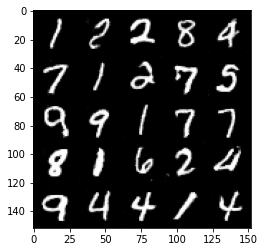

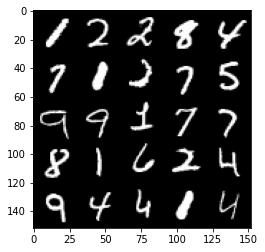

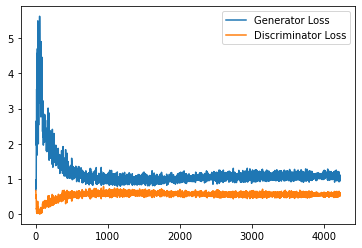

Step 85000: Generator loss: 1.0861401575803757, discriminator loss: 0.5619169607758522


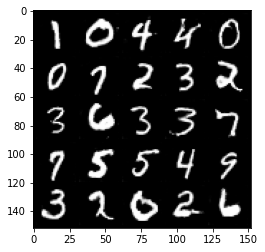

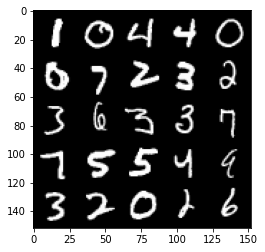

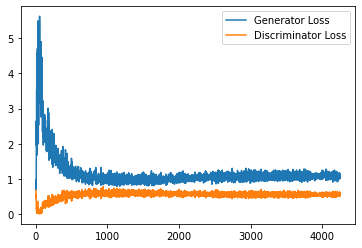

Step 85500: Generator loss: 1.096179958343506, discriminator loss: 0.5696956061720848


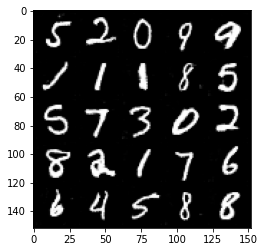

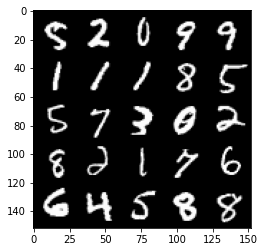

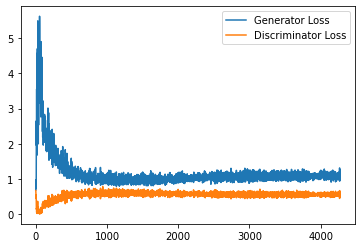

Step 86000: Generator loss: 1.0862473875284195, discriminator loss: 0.5670056556463241


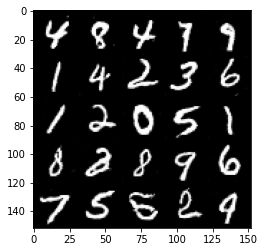

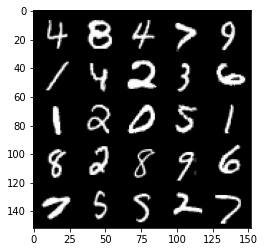

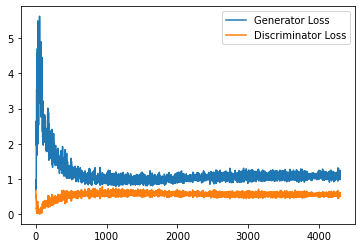

Step 86500: Generator loss: 1.0870433889627458, discriminator loss: 0.5659458171129227


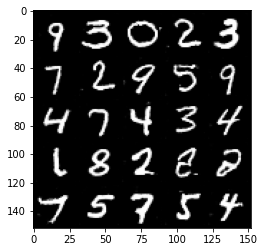

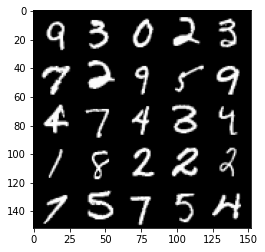

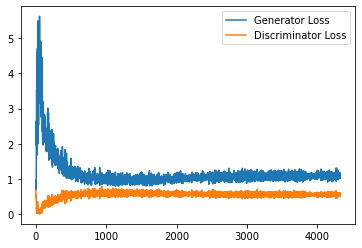

Step 87000: Generator loss: 1.0935787876844407, discriminator loss: 0.5702622817158699


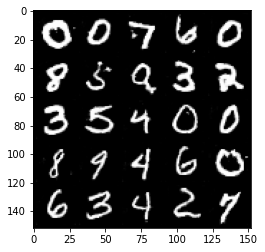

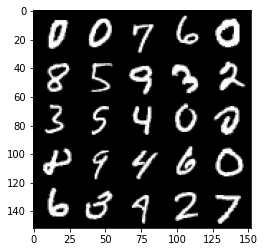

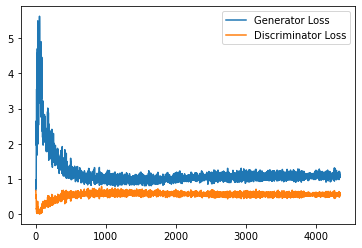

Step 87500: Generator loss: 1.0904575623273849, discriminator loss: 0.5667006914615631


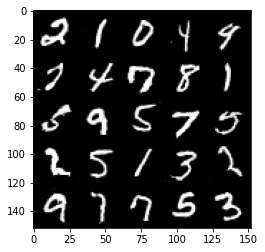

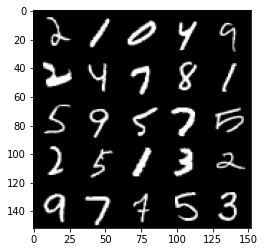

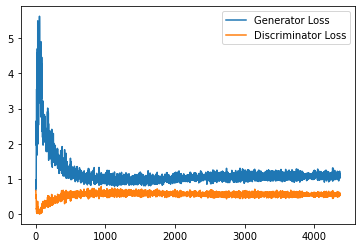

Step 88000: Generator loss: 1.080284584403038, discriminator loss: 0.5697156411409378


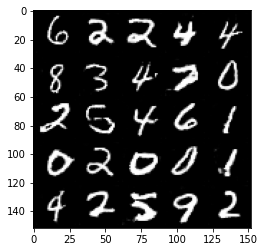

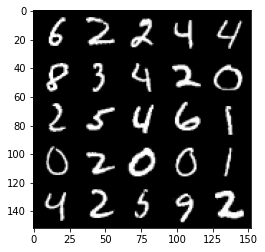

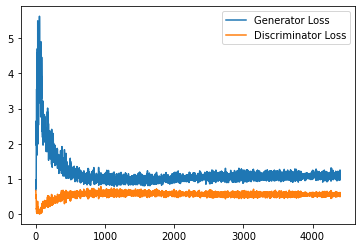

Step 88500: Generator loss: 1.0954479752779007, discriminator loss: 0.5693083465099334


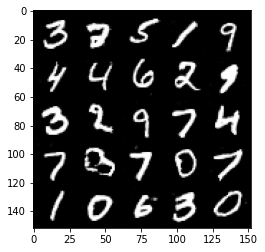

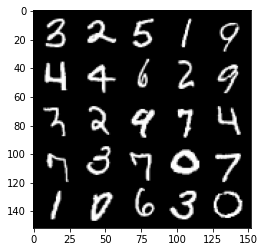

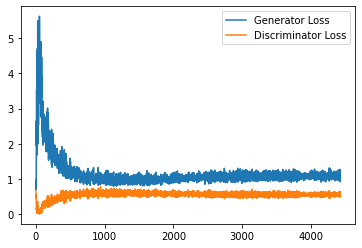

Step 89000: Generator loss: 1.0837921823263168, discriminator loss: 0.5728450056910515


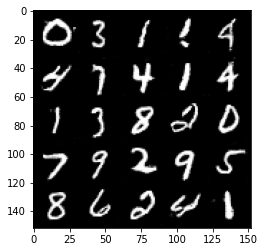

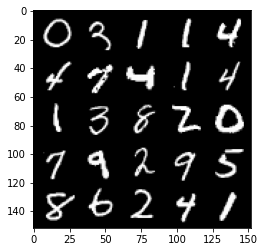

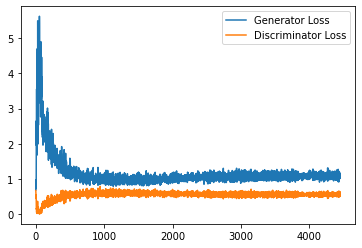

Step 89500: Generator loss: 1.1084139829874038, discriminator loss: 0.5619767296910286


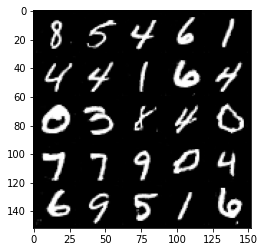

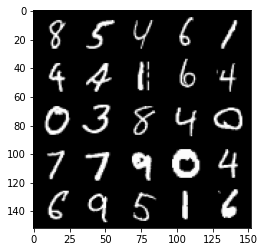

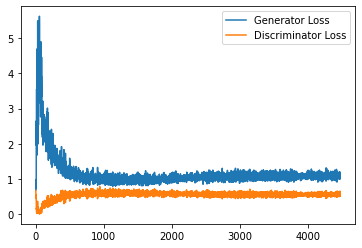

Step 90000: Generator loss: 1.0763976279497147, discriminator loss: 0.5690028682947159


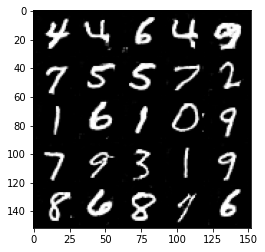

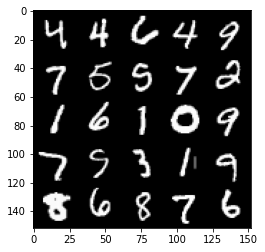

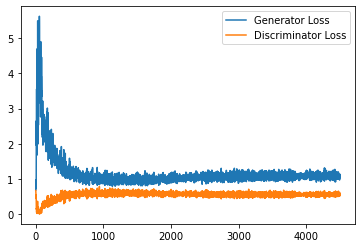

Step 90500: Generator loss: 1.079147775888443, discriminator loss: 0.5708346093297004


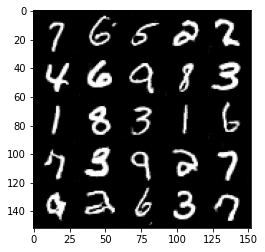

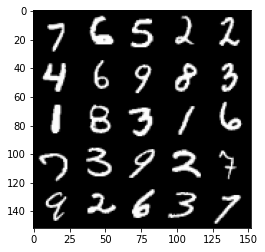

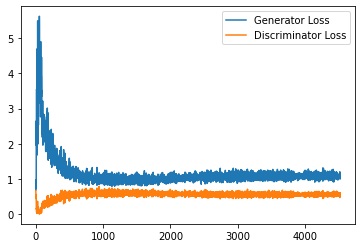

Step 91000: Generator loss: 1.0952039936780928, discriminator loss: 0.5692934669852256


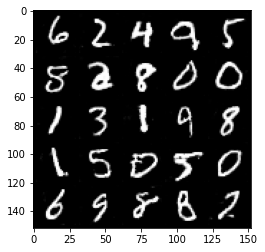

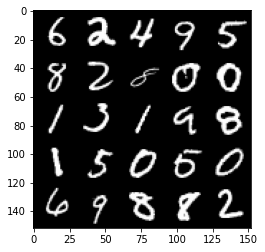

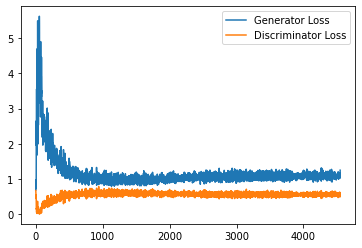

Step 91500: Generator loss: 1.093703715801239, discriminator loss: 0.5720557574033737


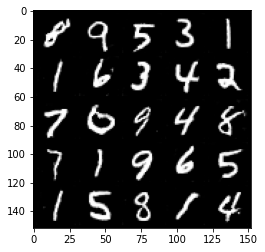

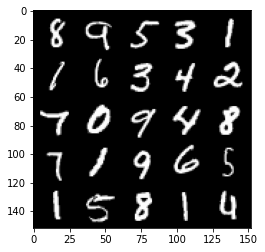

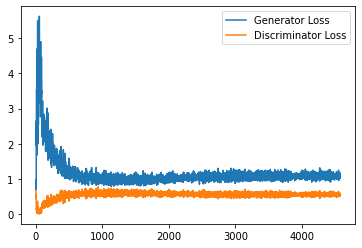

Step 92000: Generator loss: 1.0867837611436844, discriminator loss: 0.5779581302404404


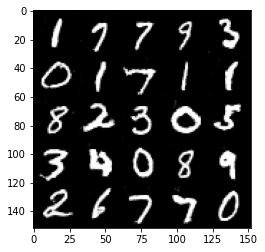

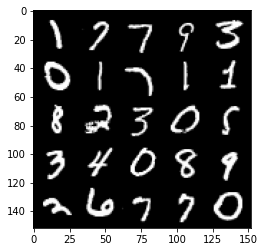

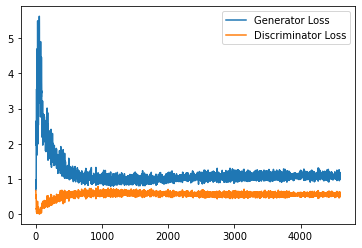

Step 92500: Generator loss: 1.0740990493297577, discriminator loss: 0.5700731232166291


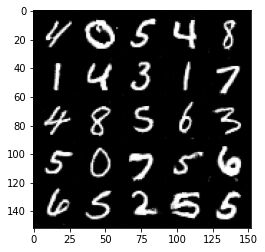

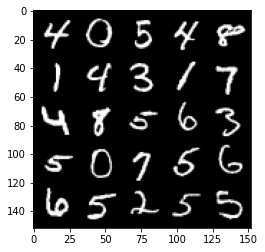

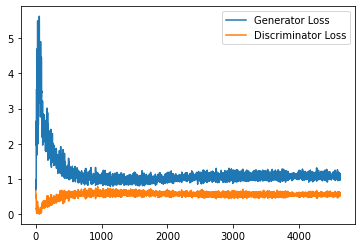

Step 93000: Generator loss: 1.0820631811618804, discriminator loss: 0.575855281829834


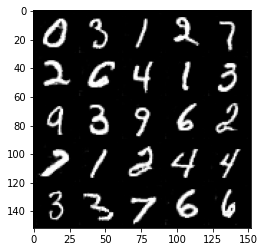

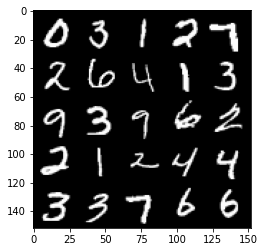

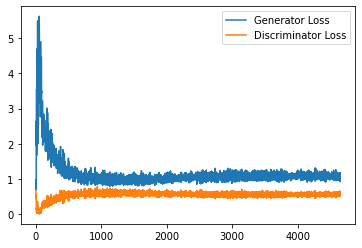

Step 93500: Generator loss: 1.1002687681913377, discriminator loss: 0.5763056454062462


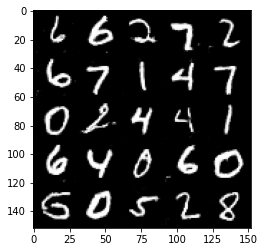

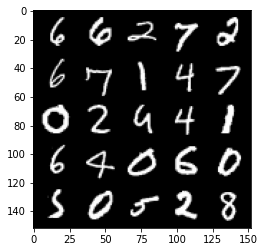

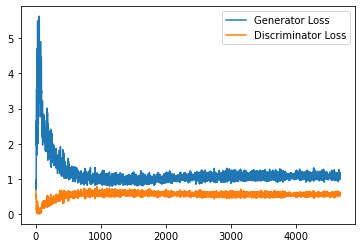

In [13]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        #print(len(one_hot_labels))
        #print('Space')
        #print(len(fake_noise))
        #print('Space')
        #print(len(image_one_hot_labels))
        
        noise_and_labels =  combine_vectors(fake_noise,one_hot_labels)
        fake = gen(noise_and_labels)
        
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        
        #print(fake.shape)
        #print(real.shape)
        #print(image_one_hot_labels.shape)
        #print((fake.detach() + image_one_hot_labels).shape)
        
        
        
        fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels) 
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)  
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        
        
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [14]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

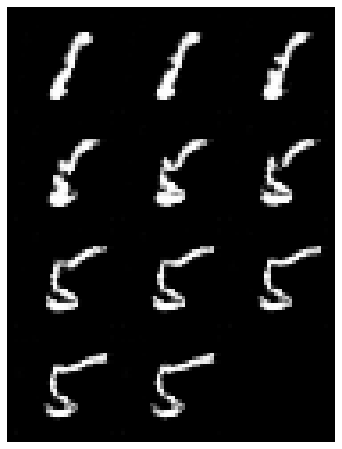

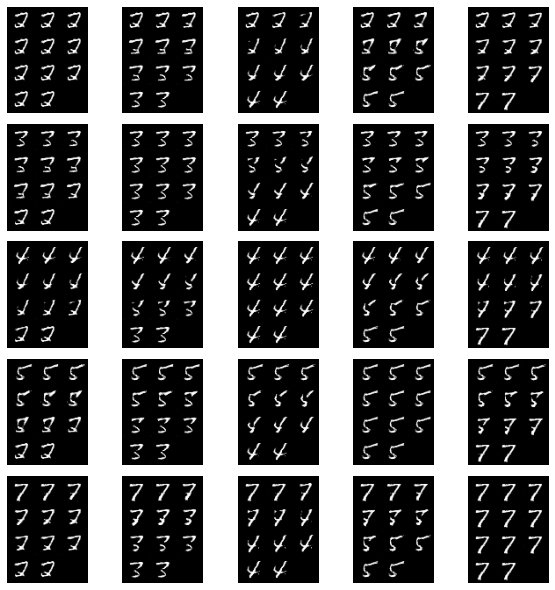

In [15]:
import math

### Change me! ###
n_interpolation = 11 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))

for i, first_plot_number in enumerate(plot_numbers):
    
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
        
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

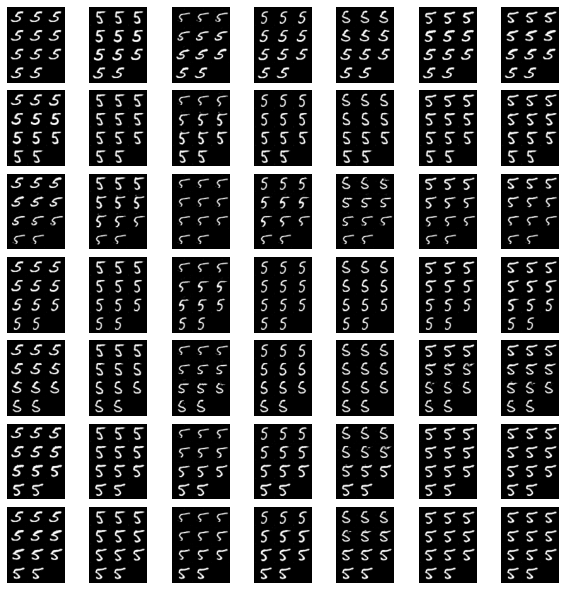

In [16]:
n_interpolation = 11 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 7 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()